In [14]:
from transformers import GPT2LMHeadModel, GPT2TokenizerFast

device = "cuda:1"
model_id = "gpt2-large"
model = GPT2LMHeadModel.from_pretrained(model_id).to(device)
tokenizer = GPT2TokenizerFast.from_pretrained(model_id)

In [15]:
import torch
from tqdm import tqdm
from torch.nn.functional import pad

def perplexity_of_fixedlength_models(dialog):
    
    max_length = model.config.n_positions
    stride = 1
    
    pad_token_id = 0
    encodings = tokenizer(" ".join(dialog), return_tensors="pt")
    seq_len = encodings.input_ids.size(1)
    padding_len = max_length -1 
    padded_input_ids = pad(torch.tensor([], dtype=torch.long), (0, padding_len), value=pad_token_id).unsqueeze(dim=0)
    encodings.input_ids = torch.cat([padded_input_ids, encodings.input_ids], dim=1)
    seq_len = encodings.input_ids.size(1)
    
    nlls = []
    prev_end_loc = padding_len
    for begin_loc in tqdm(range(0, seq_len, stride)):
        end_loc = min(begin_loc + max_length, seq_len)
        trg_len = end_loc - prev_end_loc  # may be different from max_length on the last loop 
        begin_loc = max(padding_len, begin_loc)
        input_ids = encodings.input_ids[:, begin_loc:end_loc].to(device)
        target_ids = input_ids.clone()
        target_ids[:, :-trg_len] = -100
        with torch.no_grad():
            outputs = model(input_ids, labels=target_ids)
            neg_log_likelihood = outputs.loss

        nlls.append(neg_log_likelihood.item())

        prev_end_loc = end_loc
        if end_loc == seq_len:
            break
    return nlls

In [16]:
import numpy as np
import matplotlib.pyplot as plt
import re
# Example usage
dialog = ["[Mark]: How did the report progress today?",
        "[Lisa]: It's coming along well, Mark.",
        "[Lisa]: I managed to finalize the data analysis section, and I'm now working on summarizing the key findings.", 
        "[Lisa]: Your earlier advice really helped streamline the process.",
        "[Mark]: That's fantastic to hear! I knew you'd make great progress.", 
        "[Mark]: Anything specific you want me to review or provide input on?",
        "[Lisa]: Thanks, Mark! I'll send you the draft by the end of the day.", 
        "[Lisa]: If you could take a look at the conclusion and offer any suggestions, that would be immensely helpful.",
        "[Mark]: Sure thing, Lisa.",
        "[Mark]: I'll prioritize reviewing the conclusion.",
        "[Mark]: On a different note, any exciting plans for the upcoming week?",
        "[Lisa]: Nothing out of the ordinary, Mark.",
        "[Lisa]: Just some routine tasks and a team meeting on Wednesday.",
        "[Lisa]: How about you?",
        "[Lisa]: Any challenges or projects on your radar?",
        "[Mark]: Well, I've got a presentation on Friday that I need to prepare for.",
        "[Mark]: If you have some time, I'd appreciate your thoughts on the key points.", 
        "[Mark]: We could grab a coffee and discuss it.",
        "[Lisa]: Absolutely, Mark! I'd be happy to help.",
        "[Lisa]: Let's schedule a coffee meeting for Thursday afternoon.", 
        "[Lisa]: I'll make sure to bring my notes on the report as well.",
        "[Mark]: Sounds like a plan, Lisa.", 
        "[Mark]: Looking forward to it!",
        "[Mark]: By the way, did you manage to catch up on those emails?",
        "[Lisa]: Yes, Mark.",
        "[Lisa]: I cleared out most of them.",
        "[Lisa]: Just a couple more responses to draft.",
        "[Lisa]: Your reminder actually motivated me to stay on top of things.",
        "[Mark]: Great to hear! Maintaining that inbox can be quite the task.",
        "[Mark]: Anything I can do to assist with the remaining emails?",
        "[Lisa]: Thanks for the offer, Mark, but I've got it covered.",
        "[Lisa]: I'll wrap up the last few and head out for the day.",
        "[Lisa]: Any closing thoughts or updates from your end?",
        "[Mark]: Not much, Lisa.",
        "[Mark]: Just the usual tasks and preparations for the presentation.",
        "[Mark]: If you need anything overnight or come across any challenges, feel free to reach out. Have a good evening!",
        "[Lisa]: Will do, Mark.",
        "[Lisa]: You too, have a relaxing evening and best of luck with your presentation preparation.",
        "[Lisa]: Until tomorrow!",
        "[Mark]: Lisa, have you ever considered incorporating visual elements into the report, like charts or graphs?",
        "[Lisa]: That's an interesting idea, Mark.", 
        "[Lisa]: I haven't given it much thought.",
        "[Lisa]: What benefits do you see in adding visual elements?",
        "[Mark]: Well, visual representations can often convey complex information more effectively.", 
        "[Mark]: It might enhance the report's overall impact.",
        "[Mark]: What do you think?",
        "[Lisa]: I see your point, Mark.",
        "[Lisa]: It could indeed make the data more accessible.",
        "[Lisa]: Let me explore some options and get back to you on that.",
        "[Lisa]: Any specific types of visuals you recommend?",
        "[Mark]: Perhaps a few clear graphs illustrating key trends and a concise infographic summarizing the main findings.", 
        "[Mark]: What do you think would work best for our audience?",
        "[Lisa]: Good suggestions, Mark.",
        "[Lisa]: I'll work on incorporating those elements and share a draft with you for feedback.",
        "[Lisa]: Do you have any preferences regarding the visual style?",
        "[Mark]: I trust your judgment, Lisa.",
        "[Mark]: Something clean and professional that aligns with our company's branding would be ideal.",
        "[Mark]: Let me know if you need any assistance with the design aspects.",
        "[Lisa]: Will do, Mark.",
        "[Lisa]: I appreciate your input.",
        "[Lisa]: I'll make sure the visuals complement the content effectively.",
        "[Lisa]: Anything else on your mind regarding the report?",
        "[Mark]: Not at the moment, Lisa.",
        "[Mark]: I'm eager to see how the visual elements enhance the overall presentation.",
        "[Mark]: Keep up the excellent work, and let me know if you need further support.",
        "[Lisa]: Thanks, Mark.",
        "[Lisa]: I'll strive to make it visually engaging.",
        "[Lisa]: I'll reach out if I encounter any roadblocks. Have a great day ahead!",
        "[Mark]: You too, Lisa.",
        "[Mark]: Looking forward to our coffee meeting on Thursday.",
        "[Mark]: Until then!",
        "[Lisa]: Absolutely, Mark.",
        "[Lisa]: Thursday it is. Take care!"]


answers = ["Information seeking",
"Information giving",
"Information giving",
"Information giving",
"Information giving",
"Information seeking",
"Information giving",
"Information seeking",
"Information giving",
"Information giving",
"Information seeking",
"Information giving",
"Information seeking",
"Information seeking",
"Information seeking",
"Information giving",
"Information seeking",
"Information seeking",
"Information giving",
"Information giving",
"Information giving",
"Information giving",
"Information giving",
"Information seeking",
"Information giving",
"Information giving",
"Information giving",
"Information giving",
"Information giving",
"Information seeking",
"Information seeking",
"Information giving",
"Information seeking",
"Information giving",
"Information giving",
"Information giving",
"Information giving",
"Information giving",
"Information giving",
"Information seeking",
"Information giving",
"Information giving",
"Information seeking",
"Information giving",
"Information giving",
"Information seeking",
"Information giving",
"Information giving",
"Information giving",
"Information seeking",
"Information giving",
"Information seeking",
"Information giving",
"Information giving",
"Information seeking",
"Information giving",
"Information giving",
"Information giving",
"Information giving",
"Information giving",
"Information giving",
"Information seeking",
"Information giving",
"Information giving",
"Information giving",
"Information giving",
"Information giving",
"Information giving",
"Information giving",
"Information seeking",
"Information giving",
"Information giving",
"Information giving"]

In [378]:
perpl = perplexity_of_fixedlength_models(dialog)

 49%|███████████████████████████████████████████████████████████████▋                                                                   | 969/1993 [02:36<02:45,  6.20it/s]


AssertionError: 

In [110]:
import numpy as np
import matplotlib.pyplot as plt
import nltk
from nltk.corpus import stopwords

nltk.download('punkt')
nltk.download('stopwords')
STOP_WORDS = set(stopwords.words('english'))

# Assuming 'matches', 'dialog', 'offset', and 'perpl' are defined earlier in your code
def perplexity_to_info(dialog, perpl, answers, pattern = r'\[([^\]]+)\]'):
    
    dialog = [tokenizer.decode(token, skip_special_tokens=True) for token in tokens]
    matches = re.findall(pattern, "".join(dialog))
    unique_matches = np.unique(matches)

    #encodings = tokenizer(" ".join(dialog), return_tensors="pt")
    encodings = torch.cat(tokens)
    tokens_ids_per_sentence = np.cumsum([tokenizer(p, return_tensors="pt").input_ids.size(1) for p in dialog])
    ppl_to_info = []
    prev_idx_pp = 0
    
    for idx, (match,answer) in enumerate(zip(matches,answers)):
        idx_pp = tokens_ids_per_sentence[idx]
        patt = matches[idx]
        label = re.sub(r'\[([^\]]+)\]: ', '', dialog[idx])
        tokens = encodings[prev_idx_pp:idx_pp]
        decoded = [tokenizer.decode([token], skip_special_tokens=True) for token in tokens]
        perpl_per_sent = perpl[prev_idx_pp:idx_pp]
        mean_value=np.nanmean(np.asarray(perpl_per_sent))
        prev_idx_pp=idx_pp
        ppl_to_info.append({"label":answer, "perpl": np.asarray(perpl_per_sent)})
    
    return ppl_to_info

def filter_out_common_words(words, perpl):
    # Remove stop words and corresponding perplexity values
    filtered_words = [word for word in words if word.lower().strip() not in STOP_WORDS]
    filtered_word_indices = [i for i, word in enumerate(words) if word.lower().strip() not in STOP_WORDS]
    assert len(list(np.asarray(perpl)[filtered_word_indices])) == len(filtered_words)
    return list(np.asarray(perpl)[filtered_word_indices]), filtered_word_indices


def perplexity_to_info_filtering_out_commin_words(tokens, perpl, answers, pattern=r'\[([^\]]+)\]'):
    
    dialog = [tokenizer.decode(token, skip_special_tokens=True) for token in tokens]
    matches = re.findall(pattern, "".join(dialog))
    unique_matches = np.unique(matches)

    #encodings = tokenizer(" ".join(dialog), return_tensors="pt")
    encodings = torch.cat(tokens)
    tokens_ids_per_sentence = np.cumsum([tokenizer(p, return_tensors="pt").input_ids.size(1) for p in dialog])
    
    ppl_to_info = []
    prev_idx_pp = 0
    dialog_filtered = []
    for idx, (match,answer) in enumerate(zip(matches,answers)):
        idx_pp = tokens_ids_per_sentence[idx]
        patt = matches[idx]
        label = re.sub(pattern, '', dialog[idx])
        tokens = encodings[prev_idx_pp:idx_pp]
        decoded = [tokenizer.decode([token], skip_special_tokens=True) for token in tokens]
        perpl_per_sent, filtered_word_indices = filter_out_common_words(decoded, perpl[prev_idx_pp:idx_pp])
        assert len(perpl_per_sent) == len(tokens[filtered_word_indices])
        dialog_filtered.append(tokens[filtered_word_indices])
        mean_value=np.nanmean(np.asarray(perpl_per_sent))
        prev_idx_pp=idx_pp
        ppl_to_info.append({"label":answer, "perpl": np.asarray(perpl_per_sent)})
    
    return dialog_filtered, ppl_to_info

def compute_per_user_mean_perplexity(tokens, perpl, pattern=r'\[([^\]]+)\]'):
    
    dialog = [tokenizer.decode(token, skip_special_tokens=True) for token in tokens]
    matches = re.findall(pattern, "".join(dialog))
    unique_matches = np.unique(matches)

    num_plots = len(dialog)
    # Set smaller font size
    plt.rcParams.update({'font.size': 8})
    
    #encodings = tokenizer(" ".join(dialog), return_tensors="pt")
    encodings = torch.cat(tokens)
    assert encodings.input_ids.size(1) == len(perpl)
    tokens_ids_per_sentence = np.cumsum([tokenizer(p, return_tensors="pt").input_ids.size(1) for p in dialog])

    prev_idx_pp = 0
    user_to_ppl = {}
    for idx in range(len(matches)):
        idx_pp = tokens_ids_per_sentence[idx]
        patt = matches[idx]
        tokens = encodings[prev_idx_pp:idx_pp]
        decoded = [tokenizer.decode([token], skip_special_tokens=True) for token in tokens]
        perpl_per_sent = perpl[prev_idx_pp:idx_pp]
        mean_value=np.nanmean(np.asarray(perpl_per_sent))
        if patt not in user_to_ppl:
            user_to_ppl[patt] = []
        user_to_ppl[patt].append(mean_value)
        
    return  user_to_ppl
    
def compute_graph_perplexity(tokens, perpl, pattern = r'\[([^\]]+)\]', answers=None):
    
    dialog = [tokenizer.decode(token, skip_special_tokens=True) for token in tokens]
    matches = re.findall(pattern, "".join(dialog))
    unique_matches = np.unique(matches)
    
    rows = int(np.ceil(np.sqrt(len(dialog))))
    # Create an 8x8 grid of subplots
    fig, axes = plt.subplots(rows, rows, figsize=(30, 30))
    num_plots = len(dialog)
    # Set smaller font size
    plt.rcParams.update({'font.size': 8})
    
    #encodings = tokenizer(" ".join(dialog), return_tensors="pt")
    encodings = torch.cat(tokens)

    assert len(encodings) == len(perpl)
    tokens_ids_per_sentence = np.cumsum([tokenizer(p, return_tensors="pt").input_ids.size(1) for p in dialog])

    prev_idx_pp = 0
    for idx, ax in enumerate(axes.flatten()):
        if idx < num_plots:
            idx_pp = tokens_ids_per_sentence[idx]
            patt = matches[idx]
            tokens = encodings[prev_idx_pp:idx_pp]
            decoded = [tokenizer.decode([token], skip_special_tokens=True) for token in tokens]
            perpl_per_sent = perpl[prev_idx_pp:idx_pp]
            ax.plot(np.asarray(perpl_per_sent), label=f'{patt}')
            mean_value=np.nanmean(np.asarray(perpl_per_sent))
            ax.axhline(mean_value, color='r', label=f':{mean_value:.2f}')  # Fixed the color argument
            ax.set_xticks(np.arange(len(decoded)))
            ax.set_xticklabels(decoded, rotation=90)
            if answers is not None:
                ax.set_title(f'{answers[idx]}')
            ax.legend()
            prev_idx_pp=idx_pp

    # Hide any remaining empty subplots
    for ax in axes.flatten()[num_plots:]:
        ax.axis('off')
        
    plt.subplots_adjust(hspace=0.5, top=0.95)  
    plt.suptitle("Per-Word Perplexity across the Dataset", fontsize=30)
    plt.legend()
    plt.show()

[nltk_data] Downloading package punkt to /u/sebono/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /u/sebono/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [106]:
d= ["[Mark]: How did the report progress today?",
        "[Lisa]: It's coming along well, Mark.",
        "[Lisa]: I managed to finalize the data analysis section, and I'm now working on summarizing the key findings.", 
        "[Lisa]: Your earlier advice really helped streamline the process.",
        "[Mark]: That's fantastic to hear! I knew you'd make great progress.",]
answers = ["Information giving",
        "Information giving",
        "Information giving",
        "Information seeking",
        "Information giving",
        "Information giving"]

In [14]:
ppl_d = perplexity_of_fixedlength_models(d)

  7%|███████▊                                                                                                           | 75/1099 [00:03<00:47, 21.74it/s]


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


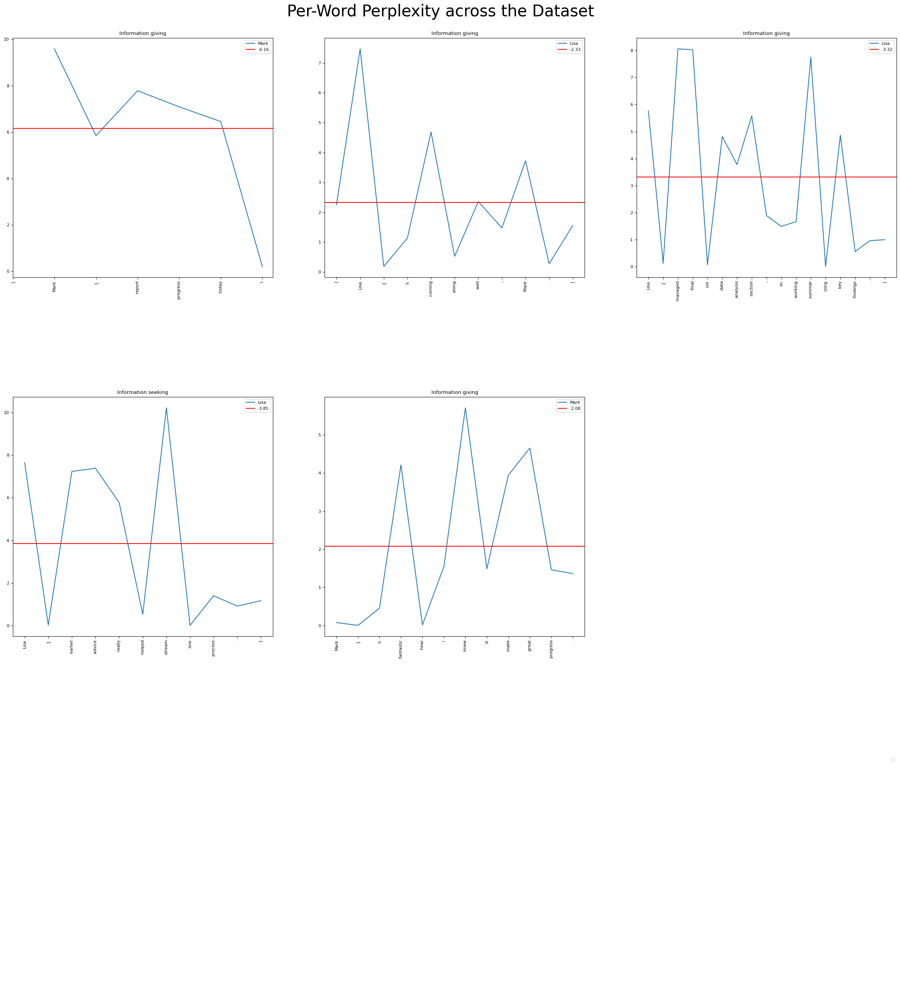

In [95]:
dialog_filtered_tokens, info = perplexity_to_info_filtering_out_commin_words(d,ppl_d,answers)
perpl = []
answers = []
for el in info:
    answers.append(el['label'])
    perpl += list(el['perpl'])
compute_graph_perplexity(dialog_filtered_tokens,perpl,answers=answers)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


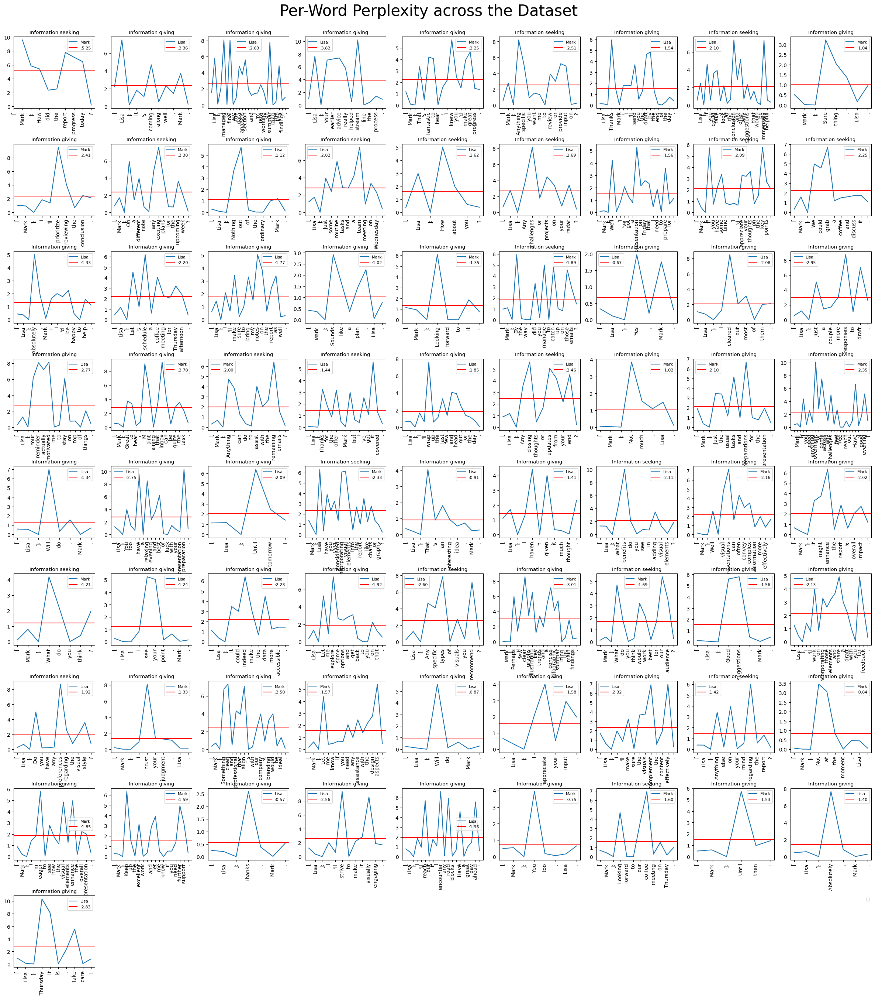

In [13]:
compute_graph_perplexity(dialog,perpl,answers)

In [ ]:

for patt, line in zip(np.unique(matches), dialog[offset + 1:]):
    idx = np.asarray([index for index, element in enumerate(matches[offset + 1:]) if element == patt])
    print(f"{patt} :", np.mean(np.asarray(perpl)[idx]))
    plt.plot(idx, np.asarray(perpl)[idx], label=f'{patt}')

# Customize x-axis ticks
num_ticks = len(dialog) - (offset + 1) # Assuming gpt1 is the array for x-axis
plt.xticks(np.arange(num_ticks), dialog[offset + 1:], rotation=90)  # Adjust rotation angle as needed

# Add labels and title
plt.xlabel('Utterance Index')
plt.ylabel('Dominance in Conversation')
plt.title('Dominance in Conversation for Each Pattern')

# Add legend
plt.legend()

# Show the plot
plt.show()
for d, p in zip(dialog[1:], perpl):
    print(f"{d}, {p}")

In [ ]:
gpt1 = [" ",
        "[D]: Hey, I've been thinking about our upcoming project. I believe we should take a more assertive approach to meet our deadlines.",
        "[S]: Oh, absolutely. I completely agree. What specific tasks do you think I should focus on to support our goals?",
        "[D]: Great. I need you to take charge of the research phase. Make sure to gather all the relevant information and compile a detailed report by the end of the week.",
        "[S]: Of course, I'll get started right away. Should I consider any specific sources or themes?",
        "[D]: I trust your judgment, but prioritize industry reports and recent studies. We need solid data to make our case.",
        "[S]: Got it. I'll make sure to provide a comprehensive overview in the report.",
        "[D]: Perfect. Additionally, I'd like you to prepare a brief presentation summarizing the key findings. We have a meeting next Monday, and your insights will be crucial.",
        "[S]: No problem. I'll ensure the presentation is concise and highlights the most important points.",
        "[D]: Good. Let me know if you need any assistance, but I expect you to handle this with minimal supervision.",
        "[S]: Thank you for entrusting me with this responsibility. I'll do my best to meet your expectations."]

pattern = r'\[([^\]]+)\]'
matches = re.findall(pattern, "".join(gpt1))
perpl = compute_perplexity(gpt1)

for patt, line in zip(np.unique(matches), gpt1[offset+1:]):
    idx = np.asarray([index for index, element in enumerate(matches[offset+1:]) if element == patt])
    print(f"{patt} :", np.mean(np.asarray(perpl)[idx]))
    print(idx)
    plt.plot(idx, np.asarray(perpl)[idx], label=f'{patt}')

# Customize x-axis ticks
offset = 0
num_ticks = len(gpt1) - (offset + 1)  # Assuming gpt1 is the array for x-axis
plt.xticks(np.arange(num_ticks), gpt1[offset+1:], rotation=90)  # Adjust rotation angle as needed

# Add labels and title
plt.xlabel('Utterance Index')
plt.ylabel('Dominance in Conversation')
plt.title('Dominance in Conversation for Each Pattern')

# Add legend
plt.legend()

# Show the plot
plt.show()


for d, p in zip(gpt1[1:], perpl):
    print(f"{d}, {p}")

In [61]:
file_path = "../data/external/gpt4_dataset/teacher_dominated.txt"
offset = 1
with open(file_path, 'r') as file:
    datasets = file.read().split('\n\n')

for dataset in datasets:
    dataset = " ".join(dataset.split("\n"))
    print(dataset)

[Teacher]: "Good morning, John. Did you complete your homework?" [Student]: "Yes, I did." [Teacher]: "Great! Can you show it to me?" [Student]: "Sure, here it is." [Teacher]: "Well done, John. Keep up the good work."
[Student]: "I have a question about the assignment." [Teacher]: "Sure, what's your question?" [Student]: "I don't understand this part." [Teacher]: "Let me explain it to you." [Student]: "Okay, I understand now. Thank you."
[Teacher]: "Let's start the class. Open your books to page 34." [Student]: "Okay." [Teacher]: "Today, we will learn about the solar system." [Student]: "Sounds interesting." [Teacher]: "Let's start with the sun."
[Student]: "I'm having trouble with this problem." [Teacher]: "Let's go through it together." [Student]: "I'm still not getting it." [Teacher]: "Don't worry. Let's try a different approach." [Student]: "That makes sense. Thanks for your help."
[Teacher]: "Today, we will have a quiz. Are you ready?" [Student]: "Yes, I am." [Teacher]: "Good. Let'

  6%|███████▊                                                                                                                            | 64/1088 [00:05<01:22, 12.43it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


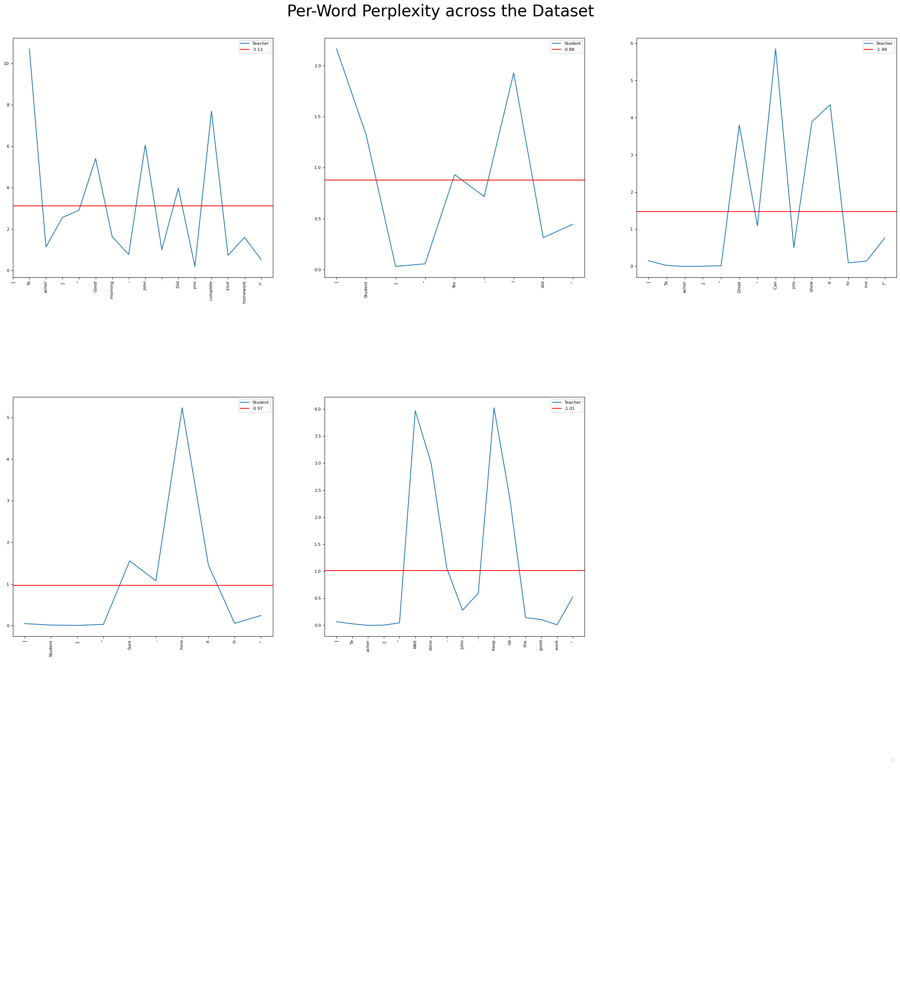

  5%|███████▏                                                                                                                            | 59/1083 [00:03<00:55, 18.33it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


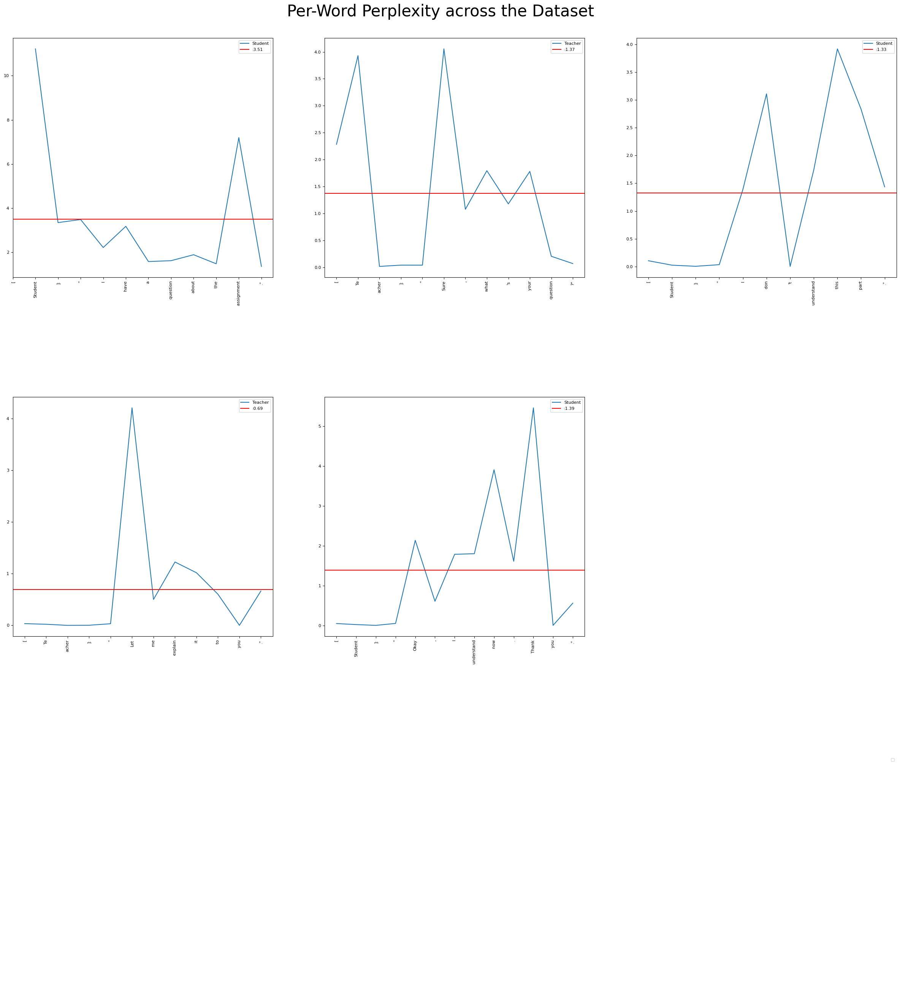

  5%|██████▉                                                                                                                             | 57/1081 [00:04<01:22, 12.44it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


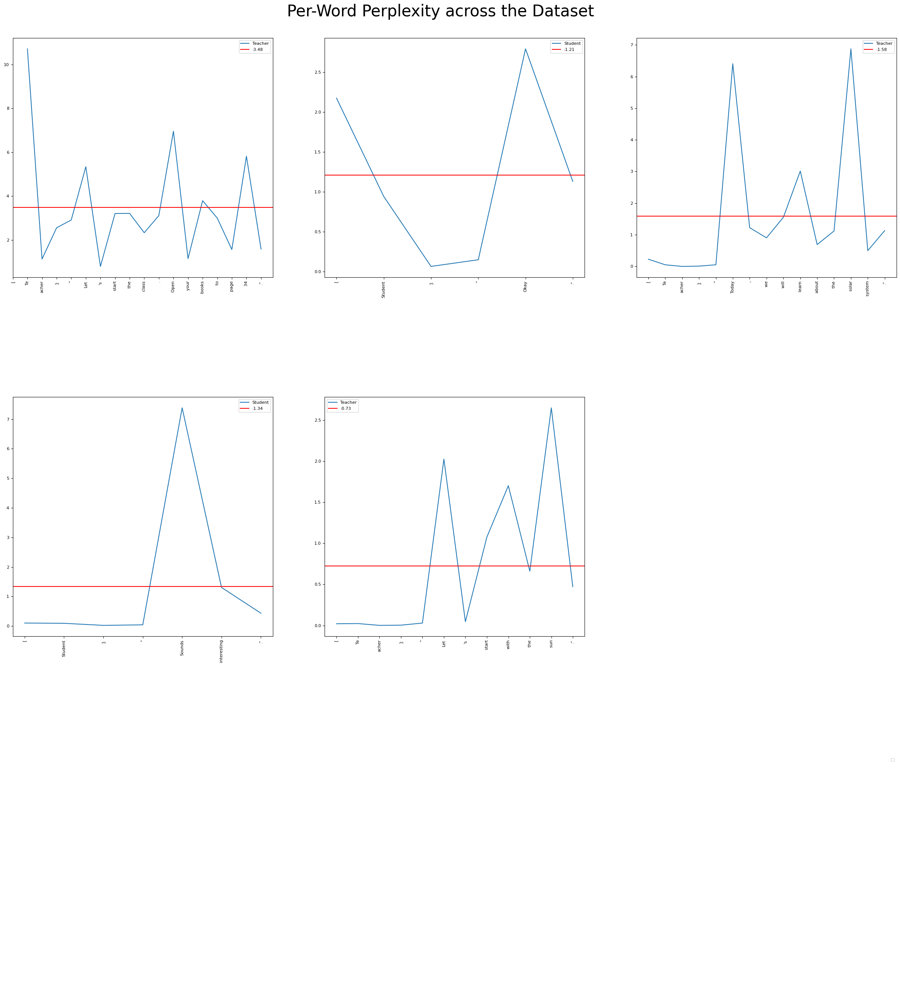

  6%|███████▋                                                                                                                            | 63/1087 [00:03<00:54, 18.94it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


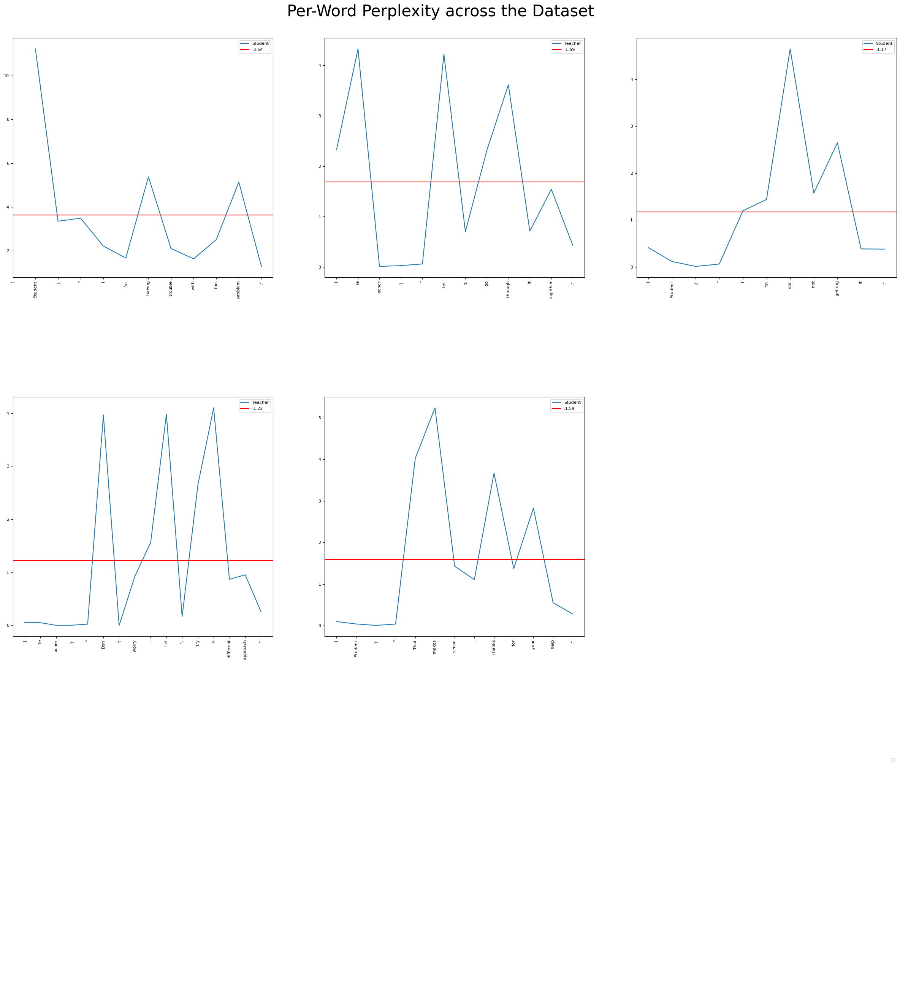

  5%|██████▉                                                                                                                             | 57/1081 [00:04<01:22, 12.48it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


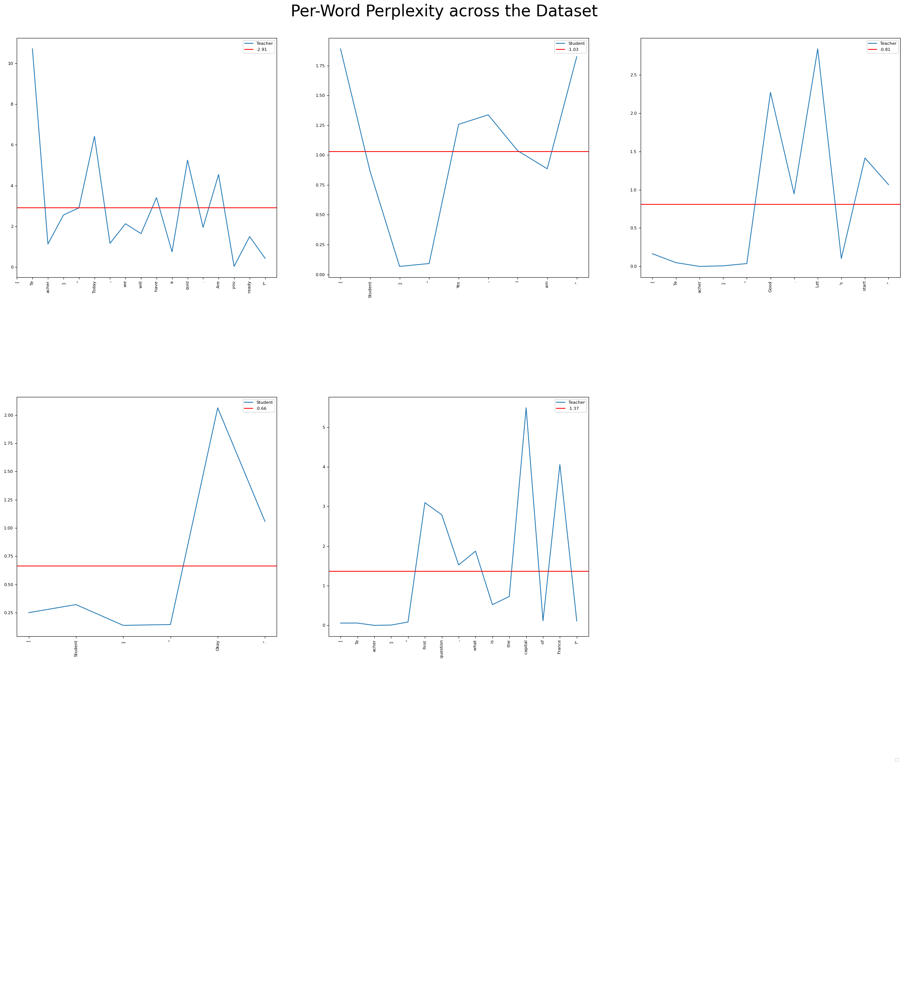

  5%|███████                                                                                                                             | 58/1082 [00:03<00:53, 19.20it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


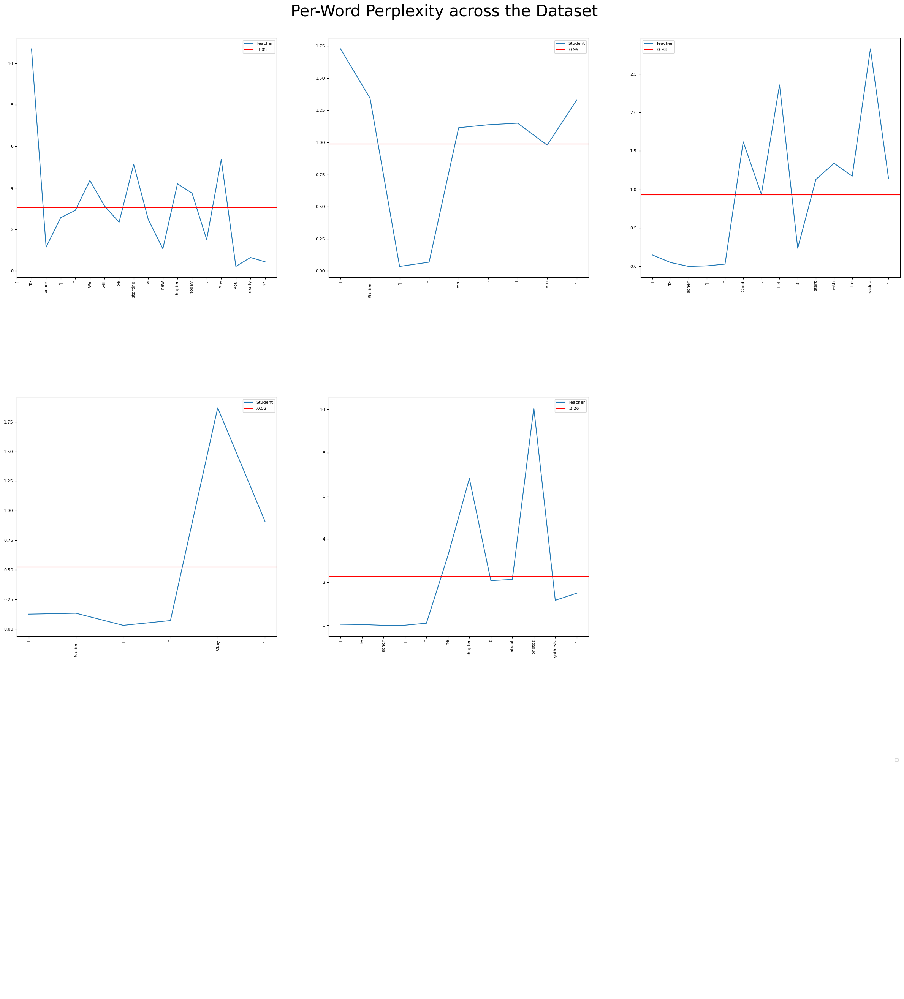

  5%|███████                                                                                                                             | 58/1082 [00:04<01:12, 14.05it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


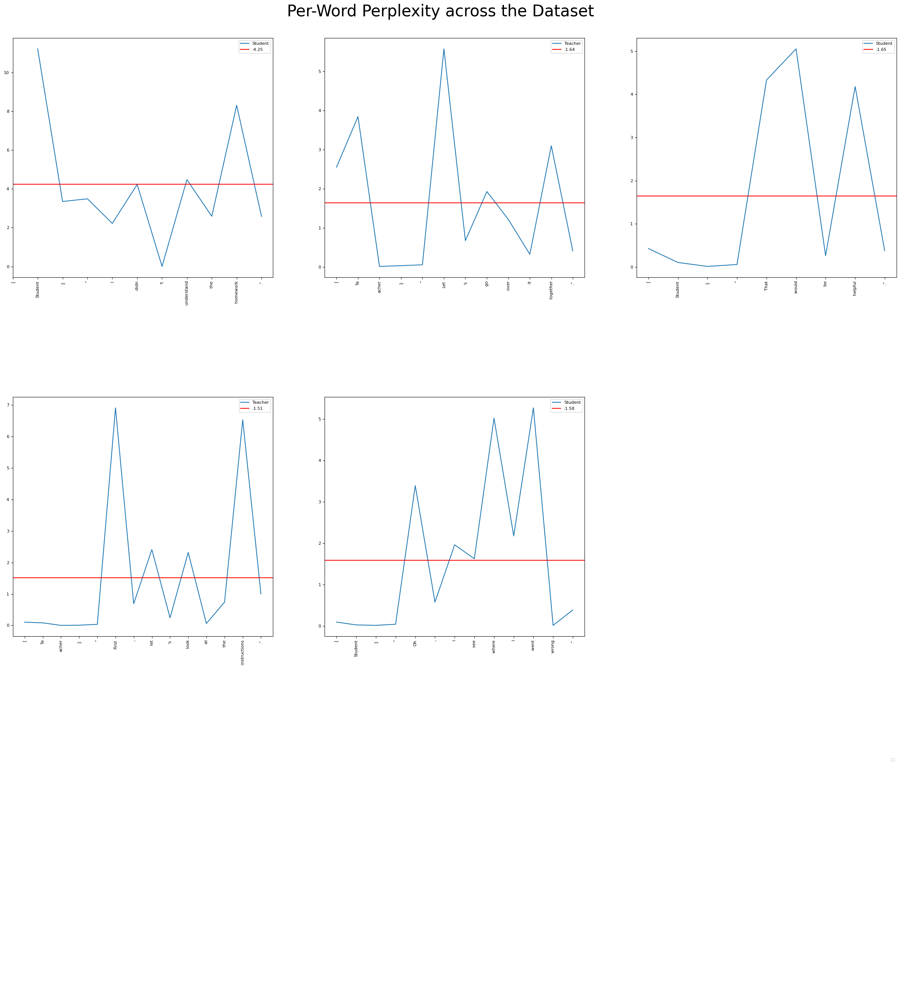

  6%|███████▌                                                                                                                            | 62/1086 [00:03<00:57, 17.84it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


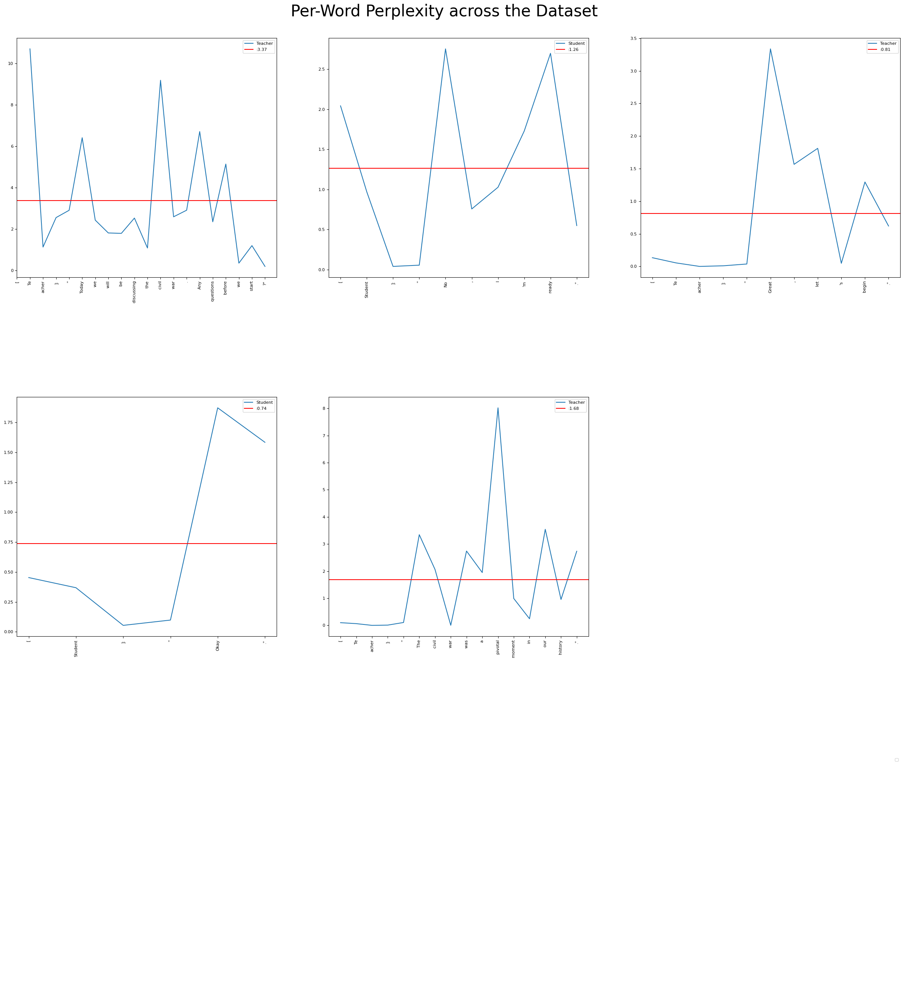

  6%|███████▎                                                                                                                            | 60/1084 [00:04<01:12, 14.14it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


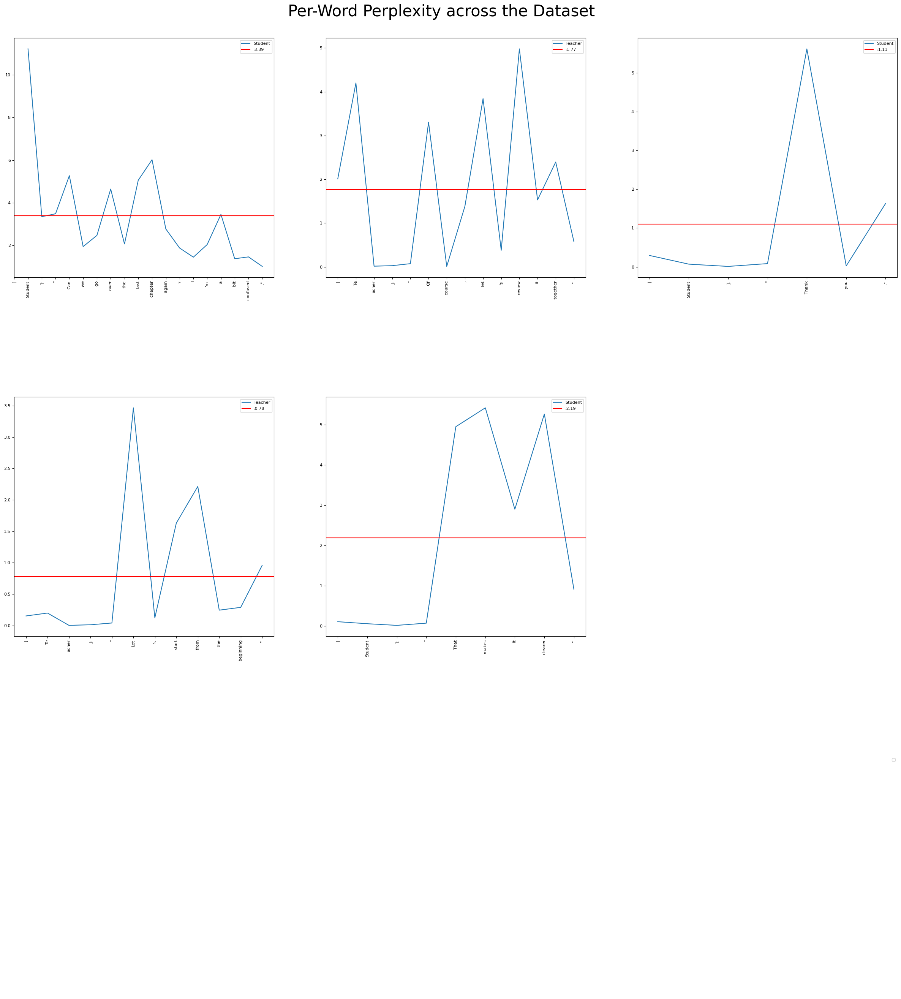

  7%|█████████▏                                                                                                                          | 77/1101 [00:05<01:11, 14.22it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


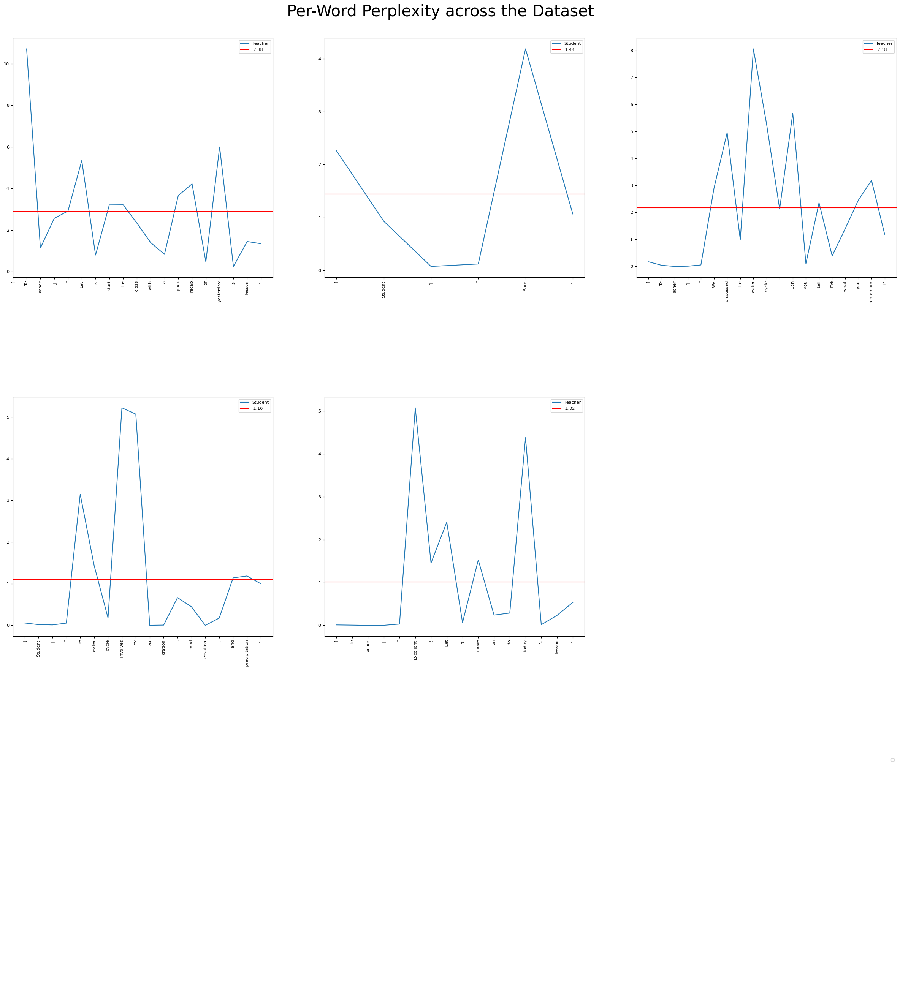

  6%|███████▉                                                                                                                            | 65/1089 [00:04<01:17, 13.14it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


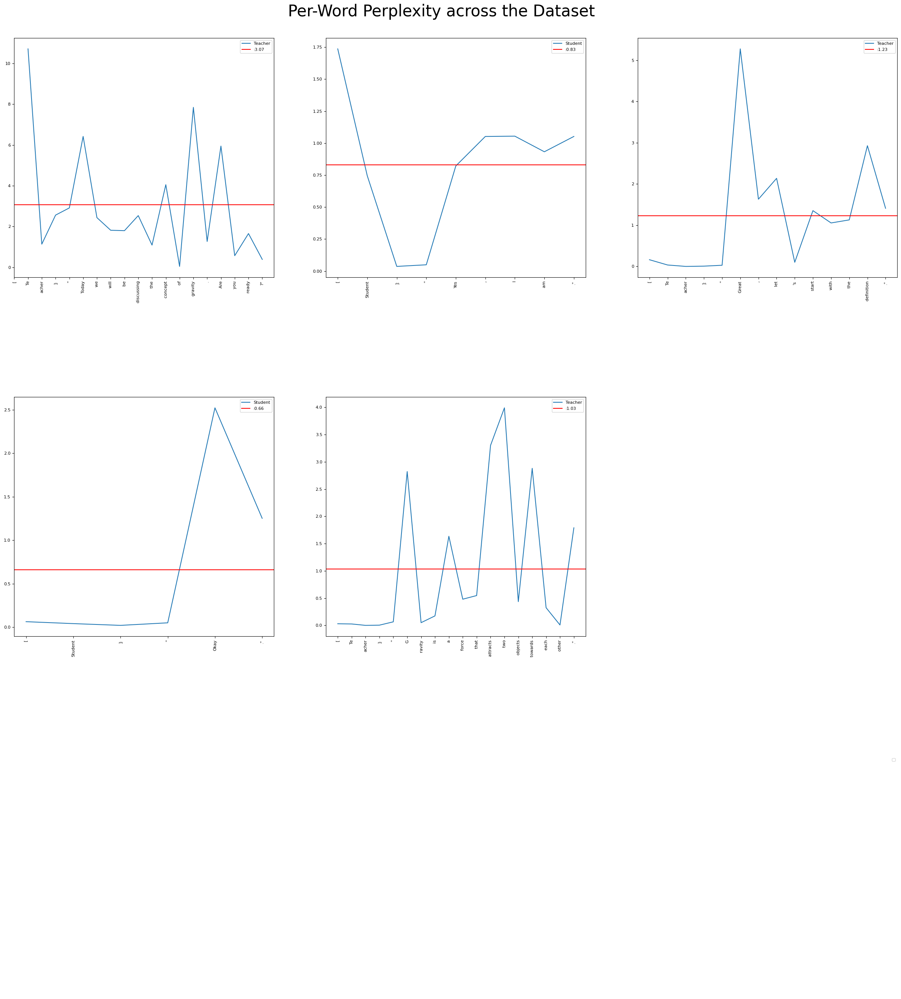

  5%|███████▏                                                                                                                            | 59/1083 [00:03<01:00, 16.79it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


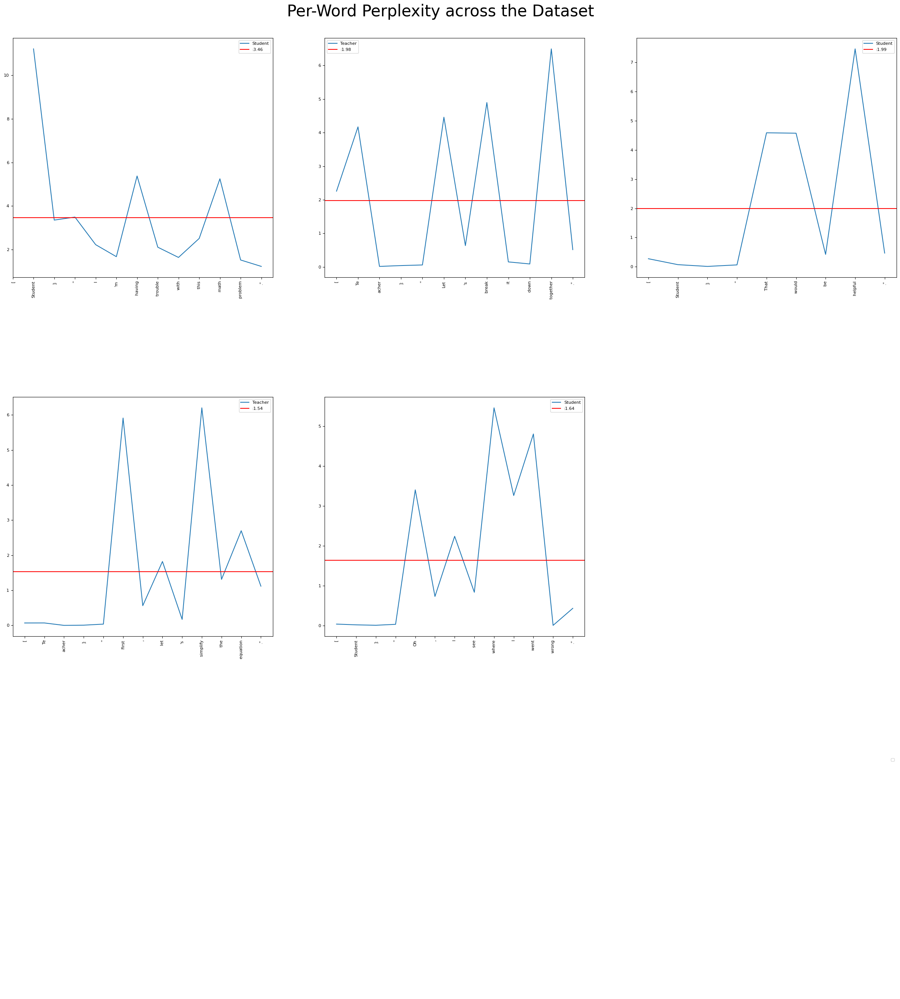

  6%|████████▍                                                                                                                           | 70/1094 [00:04<01:03, 16.06it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


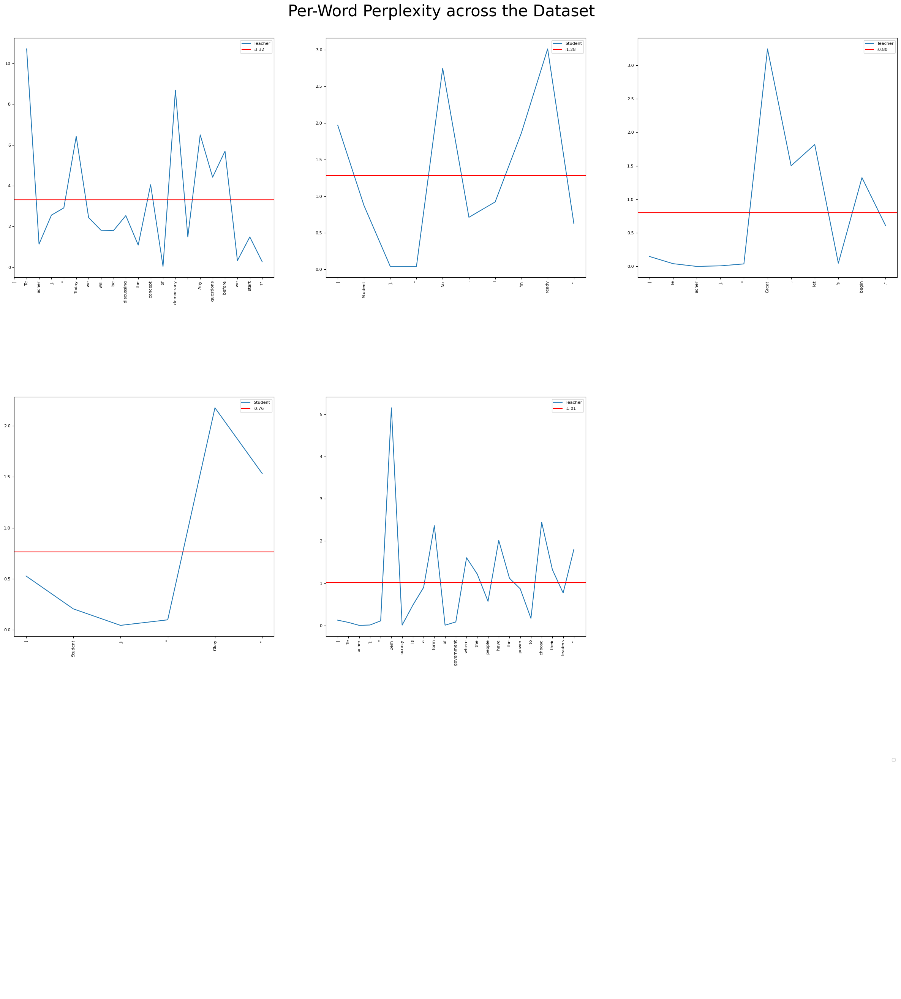

  6%|███████▎                                                                                                                            | 60/1084 [00:03<01:05, 15.67it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


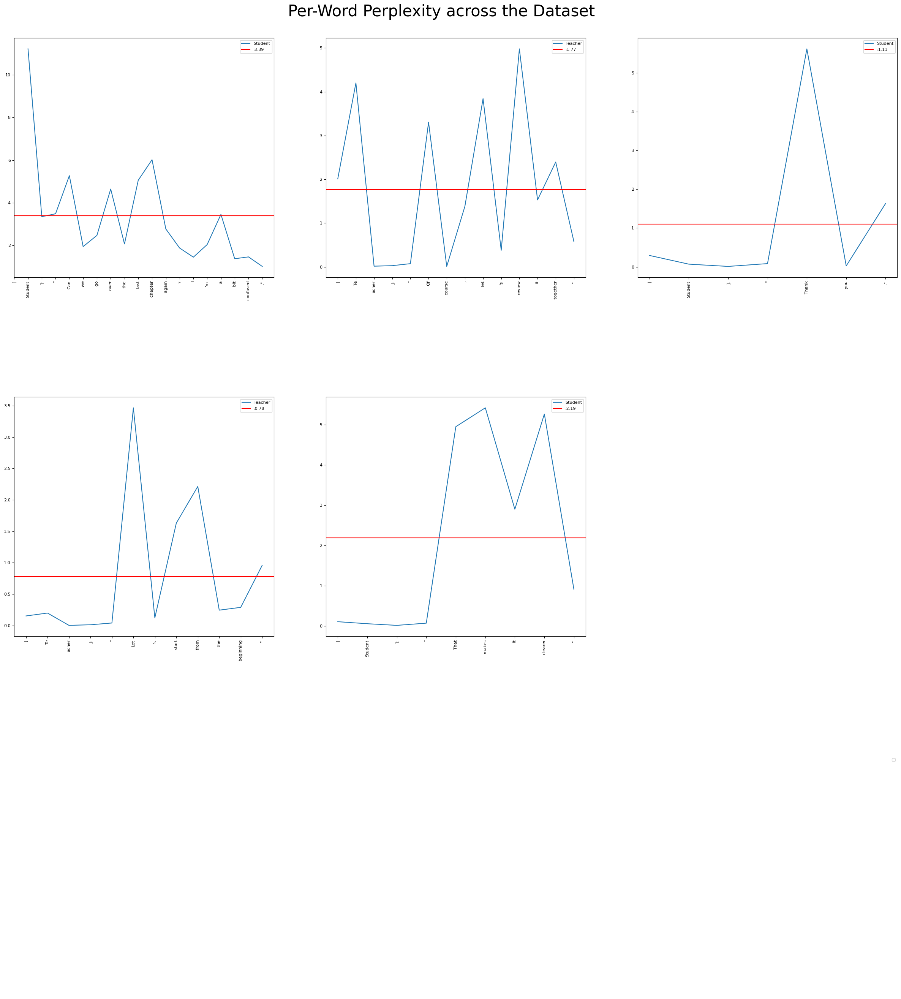

  7%|█████████▋                                                                                                                          | 81/1105 [00:05<01:06, 15.31it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


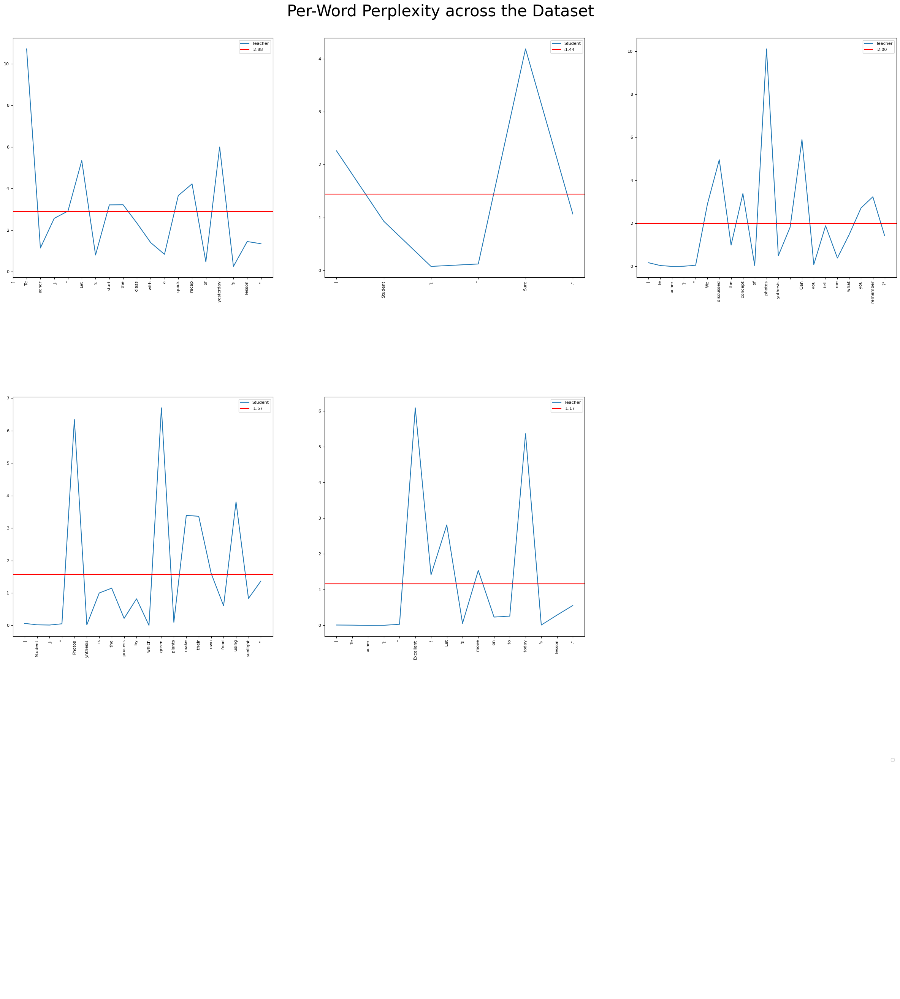

  6%|████████                                                                                                                            | 67/1091 [00:03<00:56, 18.03it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


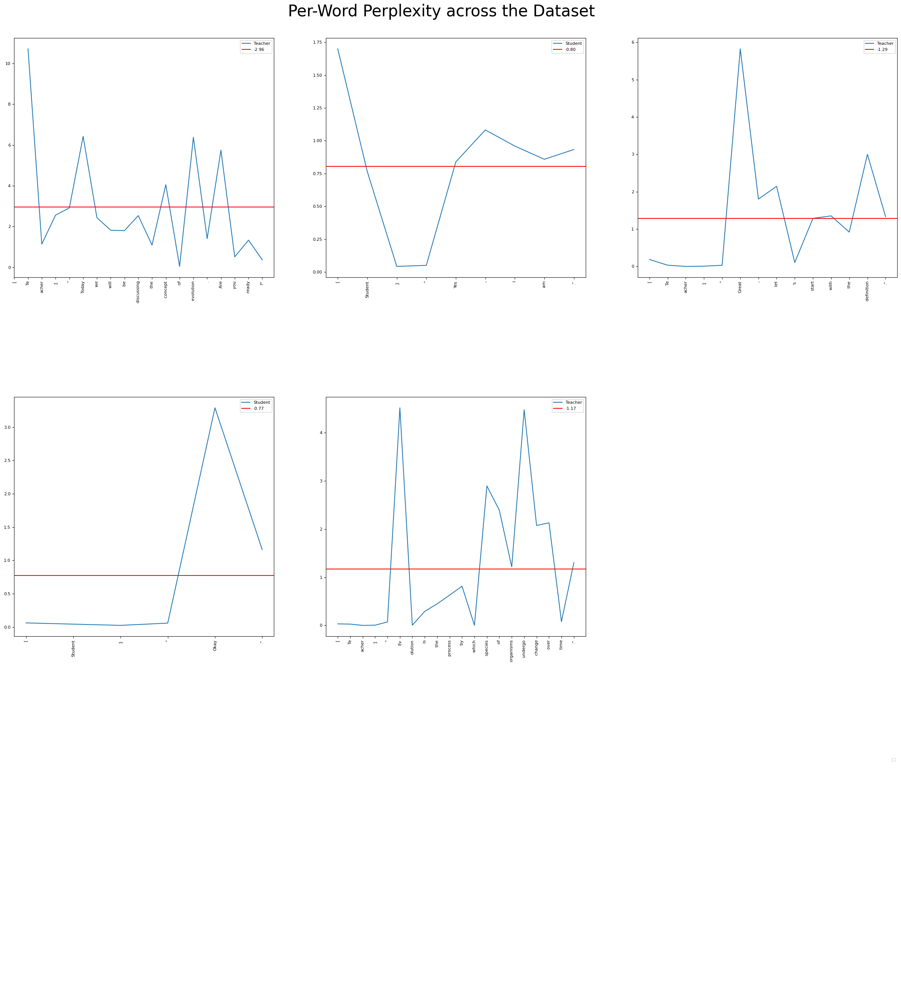

  6%|███████▋                                                                                                                            | 63/1087 [00:04<01:16, 13.40it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


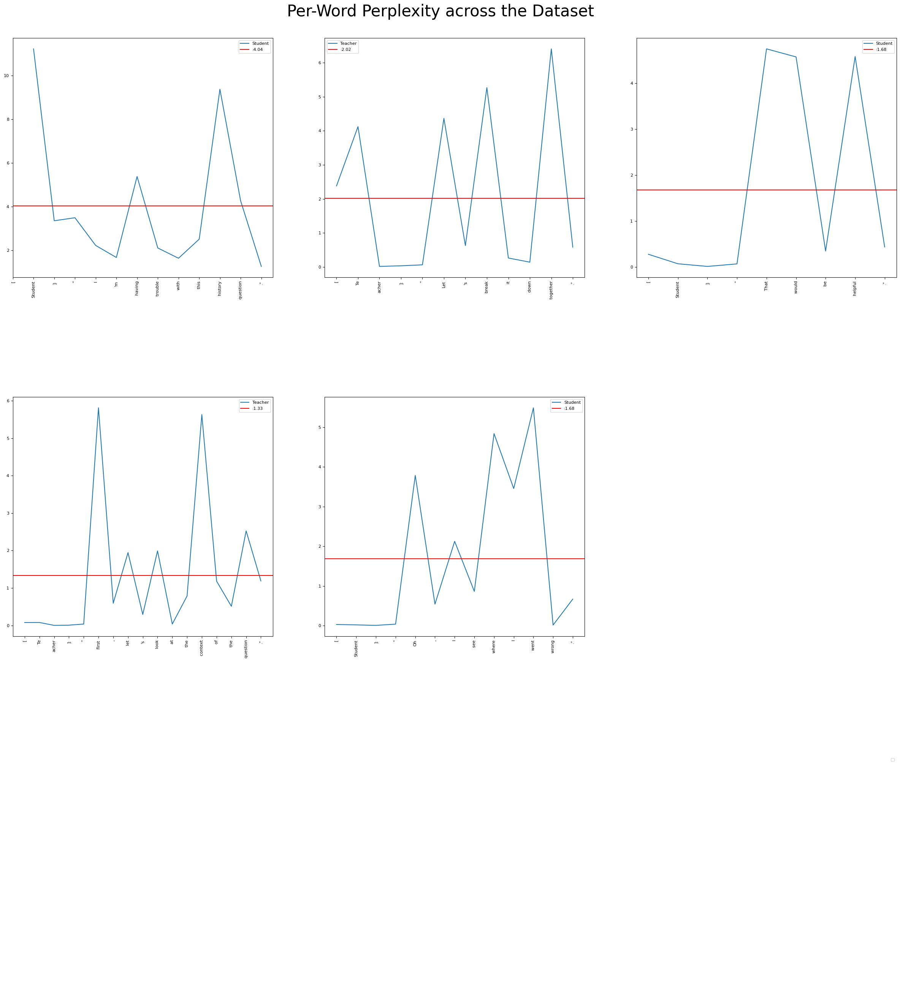

  6%|████████▌                                                                                                                           | 71/1095 [00:04<01:08, 15.02it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


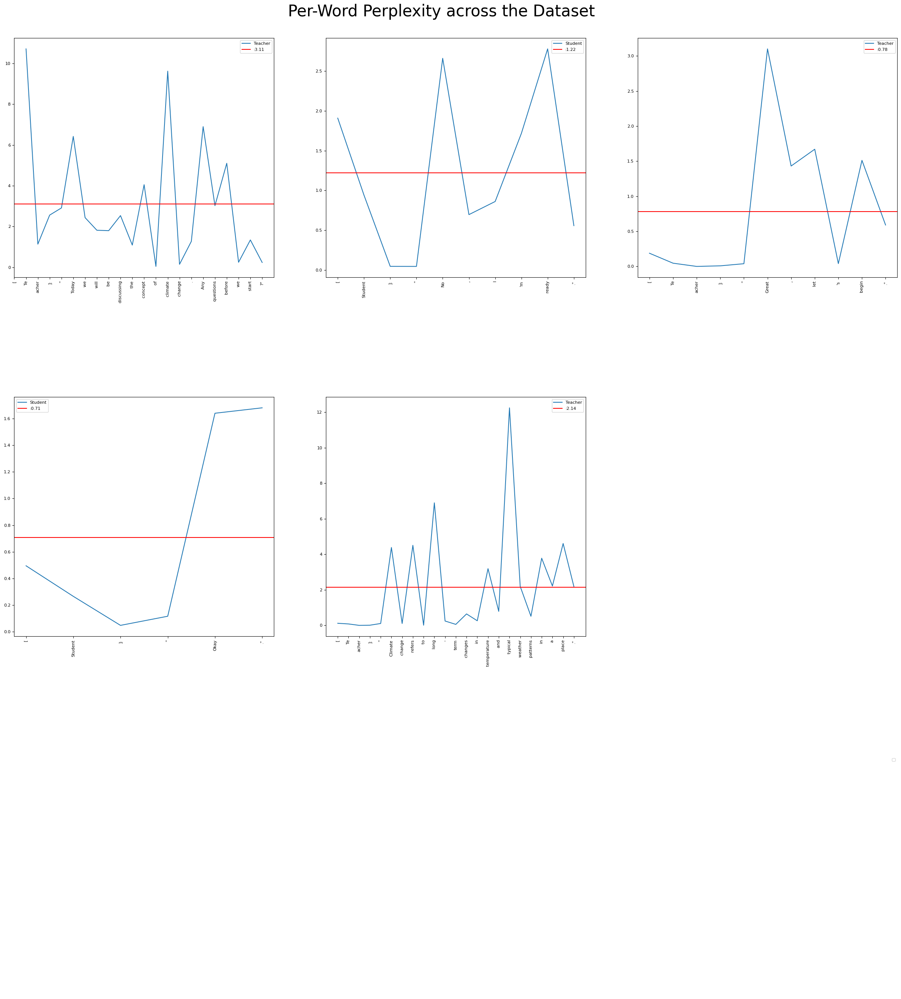

  6%|███████▎                                                                                                                            | 60/1084 [00:04<01:24, 12.12it/s]
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.

KeyboardInterrupt



In [44]:
file_path = "../data/external/gpt4_dataset/teacher_dominated.txt"
offset = 1
with open(file_path, 'r') as file:
    datasets = file.read().split('\n\n')

# Now 'dataset' is a list where each element is a chunk from the file
ppl = {}
for dataset in datasets:
    dataset = dataset.split("\n")
    pattern = r'\[([^\]]+)\]'
    matches = re.findall(pattern, "".join(dataset))    
    perpl = perplexity_of_fixedlength_models(dataset)
    ppl
    #compute_graph_perplexity(dataset,perpl)
    #perplexity_to_info_df = perplexity_to_info(dataset,perpl)

In [ ]:
pattern_idxs

In [ ]:
import re
import numpy as np
import matplotlib.pyplot as plt 
file_path = "../data/gpt4/peer-peer_data.txt"
with open(file_path, 'r') as file:
    datasets = file.read().split('\n\n')
    lables = [liner[0].replace("label: ","") for liner in [re.findall("label: \[.*\]", dataset) for dataset in datasets]]

# Now 'dataset' is a list where each element is a chunk from the file
results = {}
offset = 0
dominance_in_conv = {}
for idx, (dataset, label) in enumerate(zip(datasets,lables)):
    results[idx] = {}
    dominance_in_conv[idx] = {}
    
    dataset ="\n".join(dataset.split("\n")[:-1])
    speakers= np.unique(re.findall(r'\[([^\]]+)\]', dataset))
    prmt = f"This is a conversation between speakers [{'], ['.join(speakers)}].\nPredict the next most probable utterance:\n"
    dataset = dataset.split("\n")
    dataset = dataset
    pattern = r'\[([^\]]+)\]'
    matches = re.findall(pattern, "".join(dataset))
    perpl = compute_perplexity(dataset, prmt,offset=offset)
    
    for patt, line in zip(np.unique(matches), dataset[offset+1:]):
        pattern_idxs = np.asarray([index for index, element in enumerate(matches[offset+1:]) if element == patt])
        print(f"{patt} :", np.mean(np.asarray(perpl)[pattern_idxs]))
        plt.plot(pattern_idxs, np.asarray(perpl)[pattern_idxs], label=f'{patt}')
        pattern = f"[{patt}]"
        dominance_in_conv[idx][pattern] = np.asarray(perpl)[pattern_idxs]
        results[idx][pattern] = np.mean(np.asarray(perpl)[pattern_idxs])

    # Customize x-axis ticks
    
    num_ticks = len(dataset) - (offset + 1)  # Assuming gpt1 is the array for x-axis
    plt.xticks(np.arange(num_ticks), dataset[offset+1:], rotation=90)  # Adjust rotation angle as needed

    # Add labels and title
    plt.xlabel('Utterance Index')
    plt.ylabel('Dominance in Conversation')
    plt.title('Dominance in Conversation for Each Pattern')

    # Add legend
    plt.legend()

    # Show the plot
    plt.show()
    max_pattern = max(results[idx], key=results[idx].get)
    results[idx]["predicted"] = max_pattern
    results[idx]["label"] = label

In [ ]:
for idx, (dataset, label) in enumerate(zip(datasets,lables)):
    results[idx] = {}
    dominance_in_conv[idx] = {}
    
    dataset ="\n".join(dataset.split("\n")[:-1])
    speakers= np.unique(re.findall(r'\[([^\]]+)\]', dataset))
    prmt = f"This is a conversation between speakers [{'], ['.join(speakers)}].\nPredict the next most probable utterance:\n"
    dataset = dataset.split("\n")
    dataset = dataset
    pattern = r'\[([^\]]+)\]'
    matches = re.findall(pattern, "".join(dataset))
    perpl = compute_perplexity(dataset, prmt)
    
    for patt, line in zip(np.unique(matches), dataset[1:]):
        idx = np.asarray([index for index, element in enumerate(matches[1:]) if element == patt])
        print(f"{patt} :", np.mean(np.asarray(perpl)[idx]))
        plt.plot(idx, np.asarray(perpl)[idx], label=f'{patt}')

    # Customize x-axis ticks
    num_ticks = len(dataset) - 1  # Assuming gpt1 is the array for x-axis
    plt.xticks(np.arange(num_ticks), dataset[1:], rotation=90)  # Adjust rotation angle as needed

    # Add labels and title
    plt.xlabel('Utterance Index')
    plt.ylabel('Dominance in Conversation')
    plt.title('Dominance in Conversation for Each Pattern')

    # Add legend
    plt.legend()

    # Show the plot
    plt.show()

In [ ]:
import pandas as pd
crrct = []
for idx in list(results.keys()):
    if results[idx]["predicted"] == results[idx]["label"]:
        crrct.append(True)
    else:
        crrct.append(False)
        
sum(crrct)/len(crrct)

In [ ]:
import seaborn as sns
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt

# Assuming y_true and y_pred are your true and predicted labels
cm = confusion_matrix(y_true, y_pred)
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

### Multisimo

In [3]:
import numpy as np
import re
import pandas as pd

In [4]:
multisimo_df = pd.read_csv("../data/processed/transcript_dominance.csv")
multisimo_df

,file_name,speaker_1_1,speaker_1_2,speaker_1_3,speaker_1_4,speaker_1_5,speaker_2_1,speaker_2_2,speaker_2_3,speaker_2_4,speaker_2_5,speaker_1_dom_score,speaker_2_dom_score,file_content,speaker_1,speaker_2
0,S02,3.0,2.0,2.0,2.0,1.0,4.0,3.0,3.0,4.0,3.0,2.0,3.4,[MOD]: Ok so thanks for coming today. we're go...,P006,P007
1,S03,2.0,2.0,2.0,2.0,2.0,4.0,3.0,3.0,5.0,2.0,2.0,3.4,[MOD] Ok hello we are going to play a quiz. [...,P008,P009
2,S04,2.0,1.0,2.0,4.0,1.0,1.0,1.0,1.0,4.0,1.0,2.0,1.6,"[MOD]: ok Hello, thank you for coming today, w...",P010,P011
3,S05,4.0,4.0,4.0,4.0,3.0,3.0,2.0,3.0,1.0,1.0,3.8,2.0,"[MOD]: Ok hi welcome, thank you for coming tod...",P012,P013
4,S07,4.0,2.0,3.0,4.0,4.0,4.0,2.0,3.0,5.0,3.0,3.4,3.4,"[MOD]: [MOD]: Ok. So welcome, thank you very m...",P016,P017
5,S08,4.0,2.0,3.0,2.0,1.0,3.0,3.0,3.0,3.0,2.0,2.4,2.8,[MOD]: So good evening [SPK2]: Good evening. [...,P018,P019
6,S09,4.0,3.0,3.0,5.0,3.0,4.0,3.0,3.0,5.0,3.0,3.6,3.6,[MOD]: Ok [SPK2]: Yeah so [MOD]: So I would li...,P020,P021
7,S10,3.0,2.0,3.0,4.0,2.0,3.0,2.0,2.0,4.0,2.0,2.8,2.6,[MOD]: Ok. So I would like us to play a quiz. ...,P022,P023
8,S11,5.0,2.0,3.0,3.0,5.0,2.0,1.0,2.0,1.0,1.0,3.6,1.4,"[SPK1]: [MOD]: Right. So, I would like us to p...",P024,P025
9,S13,3.0,1.0,2.0,4.0,2.0,2.0,1.0,2.0,1.0,1.0,2.4,1.4,"[SPK1]: yeah [MOD]: Well hello, thanks very mu...",P028,P029


In [50]:
import re

dominance_scores = {}
ppl = {}
for el,path in zip(multisimo_df["file_content"], multisimo_df["file_name"]):
    dataset = re.sub(r'\[', r'\n[', el).split("\n")[1:]
    pattern = r'\[(SPK\d|MOD)\]'
    matches = re.findall(pattern, "".join(dataset))
    speakers= np.unique(re.findall(pattern, "".join(dataset)))
    prmt = f"This is a conversation between speakers [{'], ['.join(speakers)}].\nPredict the next most probable utterance:\n"
    perpl = perplexity_of_fixedlength_models(dataset)
    ppl[path] = perpl
    #compute_graph_perplexity(dataset,perpl)


 58%|█████████████████████████████████████████████████████████████████▎                                               | 2281/3950 [06:07<04:28,  6.21it/s]

KeyboardInterrupt



In [54]:
import pickle
file_path = "/u/sebono/conversational_dominance/data/processed/per-word_perplexity_multisimo.pkl"
with open(file_path, 'wb') as file:
    pickle.dump(ppl, file)

In [ ]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats
import plotly
import plotly.io as pio
pio.renderers.default = 'iframe'
import plotly.express as px
plotly.offline.init_notebook_mode(connected=True)
import seaborn as sns

In [220]:
file_path = "/u/sebono/conversational_dominance/data/processed/per-word_perplexity_multisimo.pkl"

with open(file_path, 'rb') as file:
    # Use pickle.load() to deserialize and load the dictionary from the file
    perplexity_scores = pickle.load(file)

In [450]:
perpl = []
for el in info['S02']:
    perpl += list(el['perpl'])

content = dataset_filtered['S02']
tokenizer("".join(content), return_tensors="pt", return_offsets_mapping=True).input_ids.size(1), len(perpl)

(3517, 3485)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


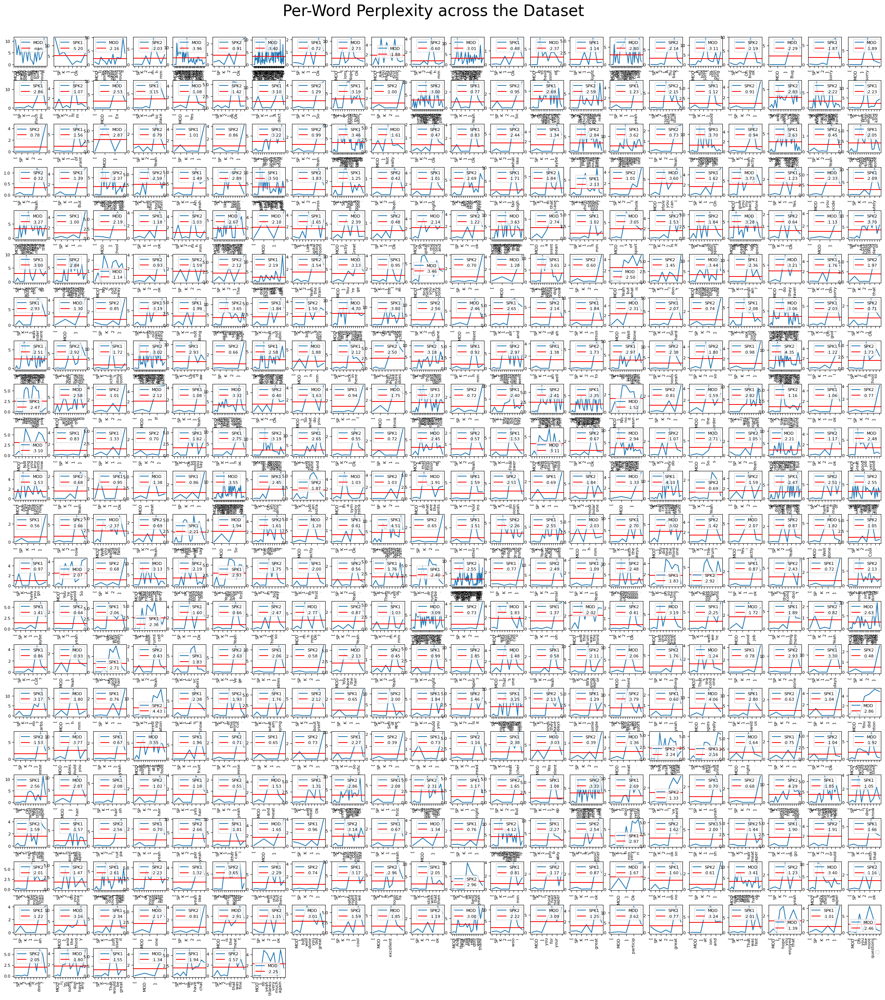

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


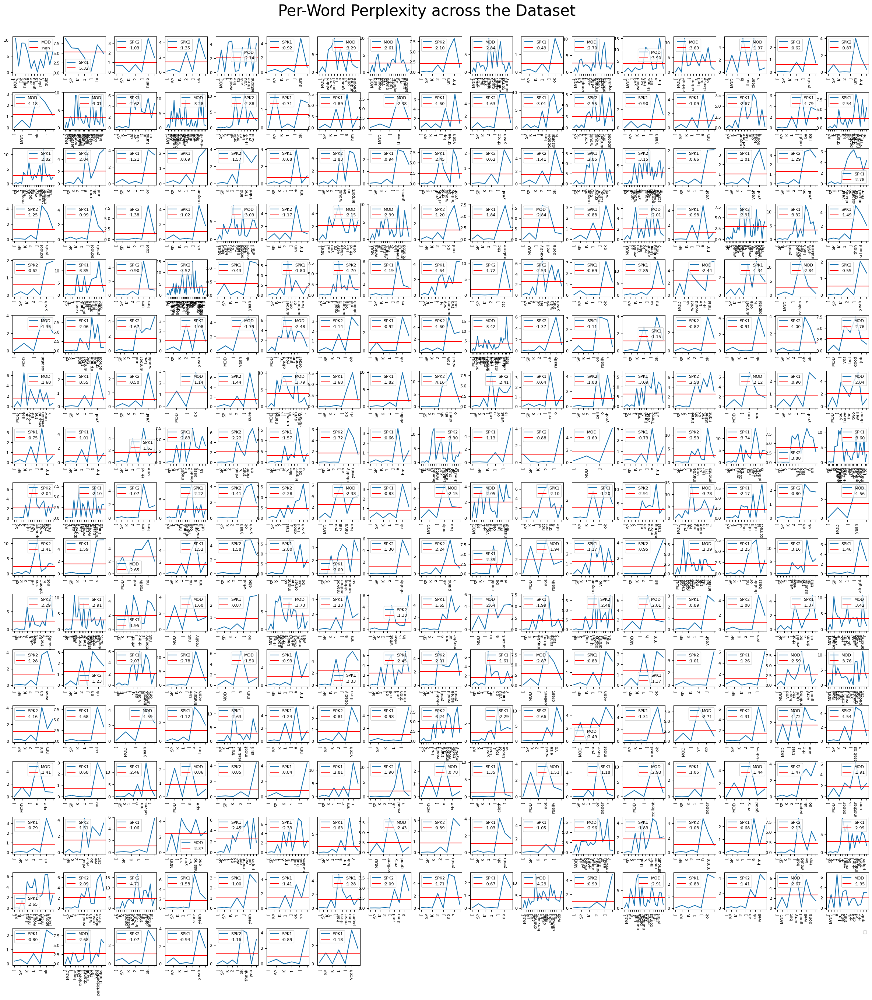

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


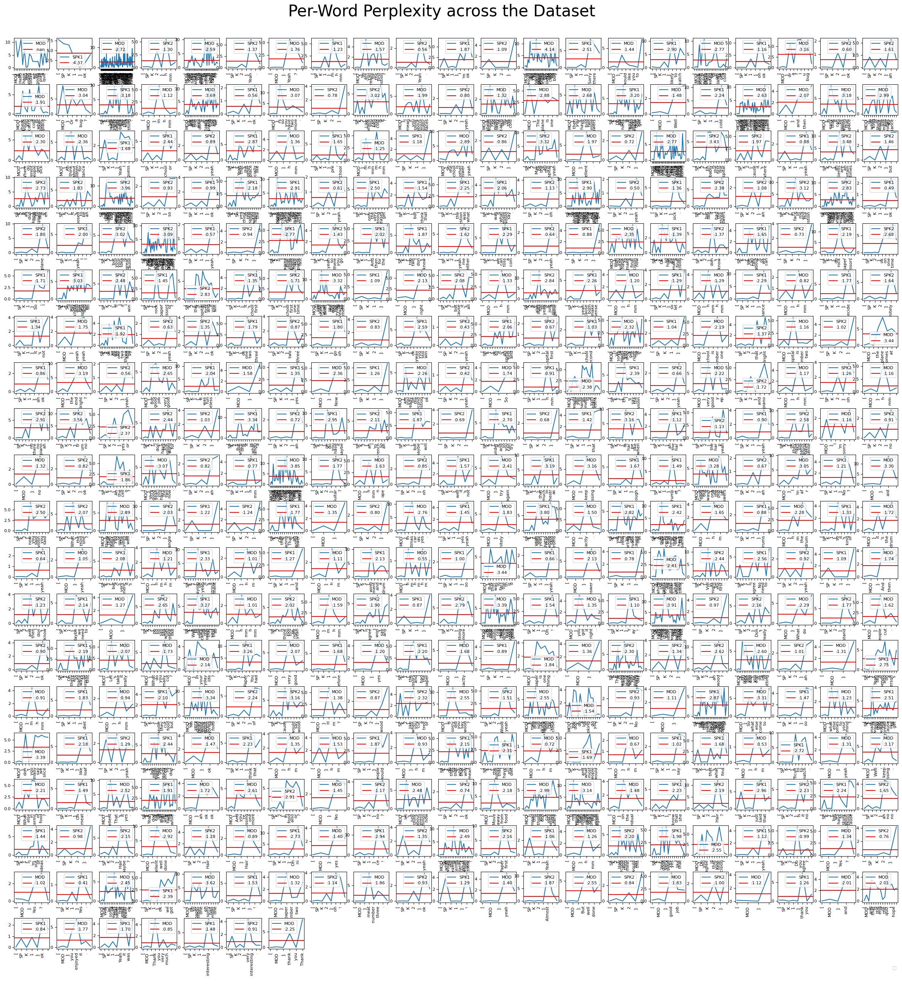

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


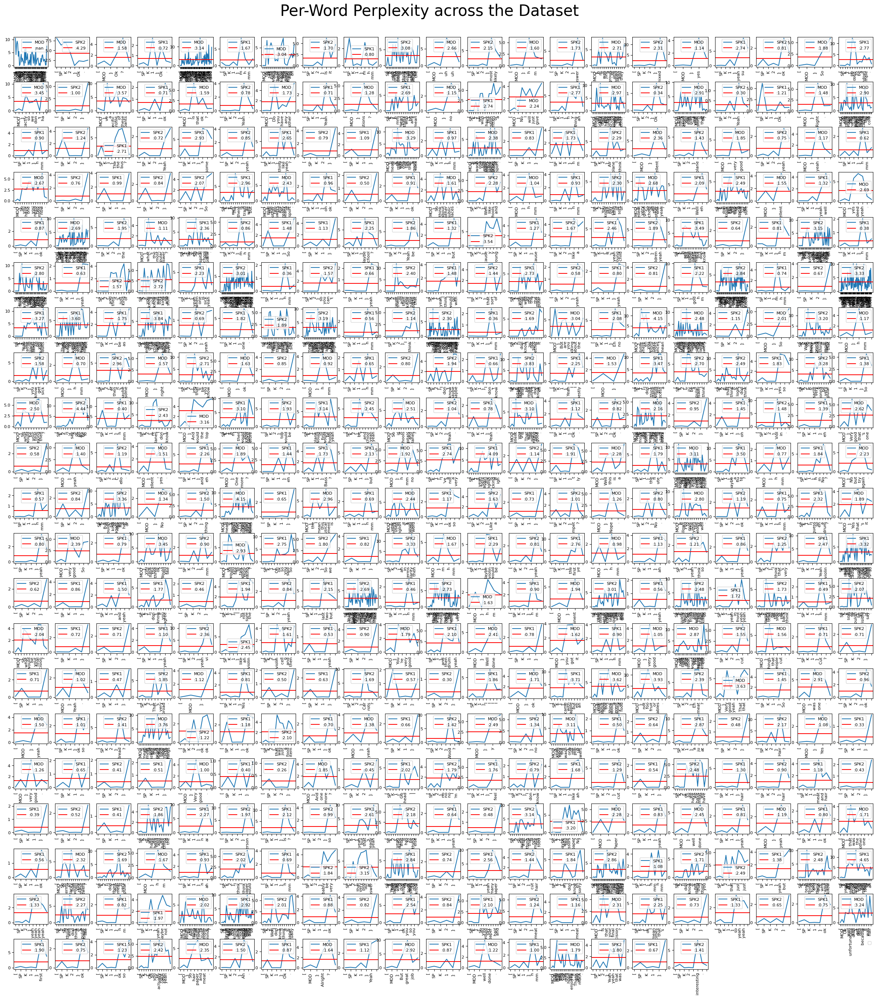

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


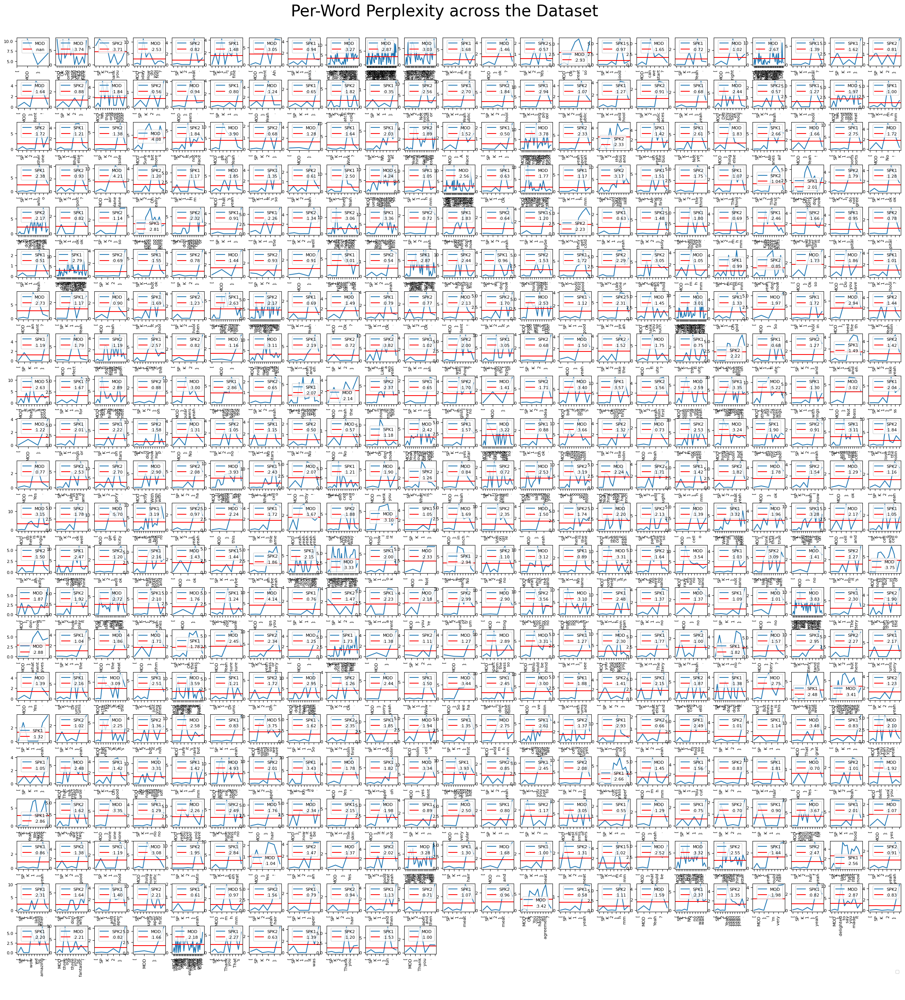

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


KeyboardInterrupt: 

In [579]:
for content, name in zip(multisimo_df["file_content"], multisimo_df["file_name"]):
    ds = re.sub(r'\[', r'\n[', content).split("\n")[1:]
    pattern = r'\[(SPK\d|MOD)\]'
    matches = re.findall(pattern, "".join(dataset))
    assert len(perplexity_scores[name]) == tokenizer(" ".join(ds), return_tensors="pt", return_offsets_mapping=True).input_ids.size(1)
    
    #compute_graph_perplexity(ds,perplexity_scores[name])

In [602]:
dominance = {}
for content, name in zip(multisimo_df["file_content"], multisimo_df["file_name"]):
    print(f"for segment {name}")
    dominance[name] = {}
    ds = re.sub(r'\[', r'\n[', content).split("\n")[1:]
    pattern = r'\[(SPK\d|MOD)\]'
    matches = re.findall(pattern, "".join(dataset))
    assert len(perplexity_scores[name]) == tokenizer(" ".join(ds), return_tensors="pt").input_ids.size(1)
    result = compute_per_user_mean_perplexity(ds,perplexity_scores[name],pattern)
    for patt in result.keys():
        print(f"{patt}: {np.mean(result[patt])}")
        dominance[name][patt] = np.mean(result[patt])

for segment S02
MOD: 2.4481425582341094
SPK1: 2.381228202146924
SPK2: 2.382918553265609
for segment S03
MOD: 2.363202788244688
SPK1: 2.303003957972115
SPK2: 2.305316540514268
for segment S04
MOD: 2.3012399306720726
SPK1: 2.3145922700286174
SPK2: 2.3138999094526373
for segment S05
MOD: 2.3242390907960853
SPK2: 2.271097891398762
SPK1: 2.2601300624679084
for segment S07
MOD: 2.188180189773482
SPK2: 2.125268894104577
SPK1: 2.1253919282881646
for segment S08
MOD: 2.4319107551318115
SPK2: 2.400547690710605
SPK1: 2.353341288840473
for segment S09
MOD: 2.2886965405244175
SPK2: 2.217195433926337
SPK1: 2.1563512645943663
for segment S10
MOD: 2.330731334686069
SPK1: 2.3230553330920696
SPK2: 2.3412280810985524
for segment S11
SPK1: 2.316899571842225
MOD: 2.3120930088386458
SPK2: 2.2767037852869088
for segment S13
SPK1: 2.173664793270841
MOD: 2.1831453446909648
SPK2: 2.1329207010128157
for segment S14
MOD: 2.2423506076228814
SPK2: 2.164741379629257
SPK1: 2.1667400332647877
for segment S17
MOD: 1.99

In [603]:
import pickle
file_path = "/u/sebono/conversational_dominance/data/processed/mean_perplexity_per-user_multisimo.pikle"
with open(file_path, 'wb') as file:
    pickle.dump(dominance, file)

In [ ]:
dialog_filtered_tokens, info = perplexity_to_info_filtering_out_commin_words(d,ppl_d,answers)
perpl = []
answers = []
for el in info:
    answers.append(el['label'])
    perpl += list(el['perpl'])
compute_graph_perplexity(dialog_filtered_tokens,perpl,answers=answers)

In [ ]:
###TO BE FIXED: there are some spaces that mess up the tokenization and detokenization

for el, dataset in zip(info, multisimo_df['file_content']):
    print(f"plotting {el}")
    dataset = re.sub(r'\[', r'\n[', content).split("\n")[1:]
    perplexity = []
    for sentence in info[el]:
        perplexity += list(sentence["perpl"]) 
    compute_graph_perplexity(dataset,perplexity)

In [542]:
for i, (info_u, dataset) in enumerate(zip(info.keys(), considered_datasets_filtered)):
    for u, d in zip(info[info_u][1:], dataset.split("\n")[1:]):
        """filtering out assertive sentences like "'[Teacher]: "Very good. Continue."',
             '[Teacher]: "Please, go ahead."',
             '[Teacher]: "That\'s correct."',
             '[Teacher]: "Very good. Continue."',"""
        per_label_ppl[u['label']] += list(u['perpl'])
        per_label_dataset[u['label']].append(d)

### Tobedone when we have labels for MULTISIMO

In [213]:
considered_datasets =multisimo_df["file_content"]

per_label_dataset={"Information seeking":[], "Information giving":[],"same":[]}
per_label_ppl={"Information seeking":[], "Information giving":[],"same":[]}

for dataset in considered_datasets:
    dataset = dataset.split("\n")
    labels = ["same" for _ in range(len(dataset))]
    encodings = tokenizer(dataset, return_tensors="pt")
    tokens_ids_per_sentence = np.cumsum([tokenizer(p, return_tensors="pt").input_ids.size(1) for p in dialog])
    prev_idx_pp = 0
    for idx, (d, l) in enumerate(zip(dataset,labels)):
        idx_pp = tokens_ids_per_sentence[idx]
        offset_ppl = len(tokenizer(d, return_tensors="pt"))
        per_label_dataset[l].append(d)
        per_label_ppl[l] += perplexity_scores[idx][prev_idx_pp:idx_pp]
        prev_idx_pp=idx_pp

### Teacher Dominated

In [124]:
import pandas as pd
file_path = "/u/sebono/conversational_dominance/data/results/information_labels__teacher_dominated__withneutral.csv"
datasets = pd.read_csv(file_path).reset_index()

In [10]:
ppl = {}
for index, dataset in zip(datasets["index"],datasets["transcript"]):
    dataset = dataset.split("\n")
    pattern = r'\[([^\]]+)\]'
    matches = re.findall(pattern, "".join(dataset))    
    perpl = perplexity_of_fixedlength_models(dataset)
    ppl[index] = perpl

NameError: name 'model' is not defined

In [117]:
import pickle
file_path = "/u/sebono/conversational_dominance/data/results/information_labels__teacher_dominated__withneutral_perplexity_scores.pikle"
with open(file_path, 'wb') as file:
    pickle.dump(ppl, file)

In [102]:
import pickle
file_path = "/u/sebono/conversational_dominance/data/results/information_labels__teacher_dominated__withneutral_perplexity_scores.pikle"
with open(file_path, 'rb') as file:
    perplexity_scores = pickle.load(file)

In [123]:
considered_indices = datasets[datasets["n_responses_match"] == True]["index"]
considered_datasets =  datasets[datasets["n_responses_match"] == True]

considered_datasets["transcript"].iloc[-1]

'[Student]: "Miss, I\'m feeling stressed about the upcoming exams. I\'m not sure how to manage it."\n[Teacher]: "It\'s normal to feel stressed before exams. But there are ways to manage it. Firstly, create a study schedule. This will help you stay organized and reduce anxiety."\n[Student]: "I have a schedule but I still feel overwhelmed."\n[Teacher]: "In that case, try some relaxation techniques like deep breathing or meditation. Also, make sure to take breaks and get enough sleep."\n[Student]: "I\'ll try that. Thank you, Miss."\n'

In [139]:
considered_indices = datasets[datasets["n_responses_match"] == True]["index"]
considered_datasets =  datasets[datasets["n_responses_match"] == True]

per_label_dataset={"Information seeking":[],"Neutral": [],  "Information giving":[]}
per_label_ppl={"Information seeking":[], "Neutral": [], "Information giving":[]}

info = {}
considered_datasets_filtered = []
for dataset, response, ppl_idx in zip(considered_datasets["transcript"],considered_datasets["response"], considered_indices):
    encodings = [tokenizer(d, return_tensors="pt").input_ids[0] for d in dataset.split("\n")]
    #print(dataset)
    dataset_filtered, info[ppl_idx] = perplexity_to_info_filtering_out_commin_words(encodings,perplexity_scores[ppl_idx],response.split("\n"))
    considered_datasets_filtered.append(dataset_filtered)

In [140]:
per_label_dataset={"Information seeking":[],"Neutral": [],  "Information giving":[]}
per_label_ppl={"Information seeking":[], "Neutral": [], "Information giving":[]}
for i, (info_u, dataset) in enumerate(zip(info.keys(), considered_datasets_filtered)):
    for u, d in zip(info[info_u], dataset):
        """filtering out assertive sentences like "'[Teacher]: "Very good. Continue."',
             '[Teacher]: "Please, go ahead."',
             '[Teacher]: "That\'s correct."',
             '[Teacher]: "Very good. Continue."',"""
        assert len(u['perpl']) == len(d)
        per_label_ppl[u['label']] += list(u['perpl'])
        per_label_dataset[u['label']].append(d)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


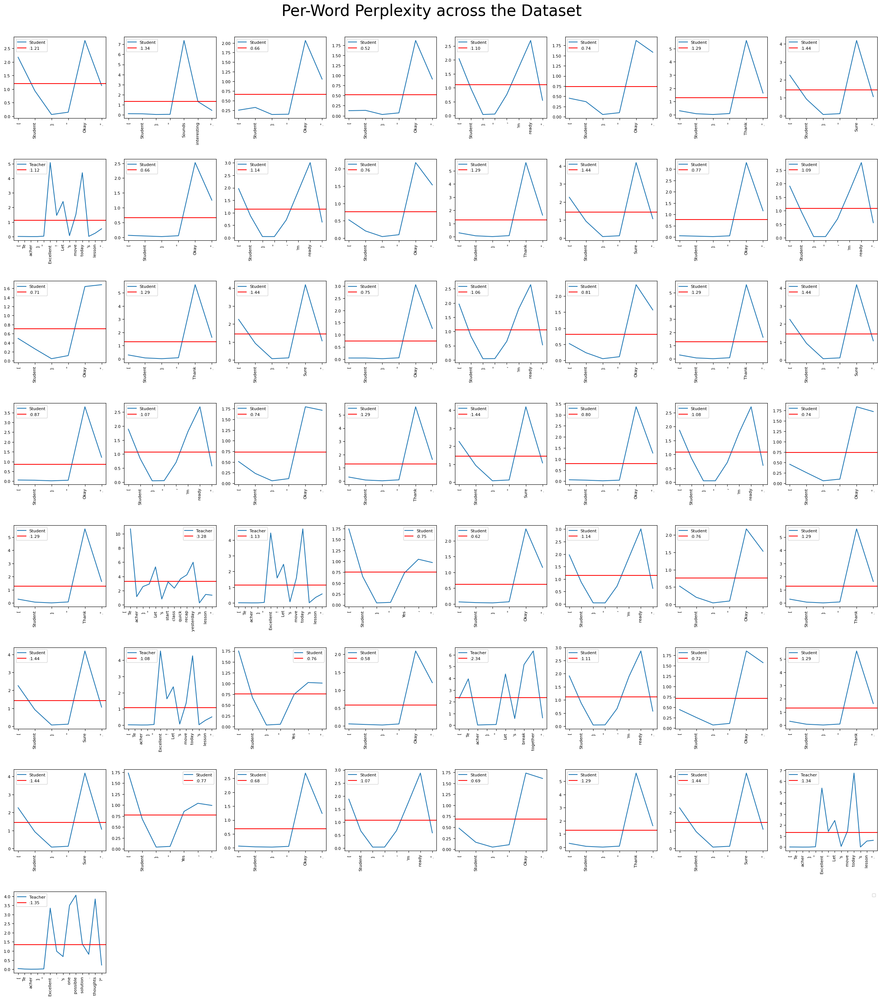

In [141]:
#information giving
tokens = per_label_dataset["Neutral"]
perplexity = per_label_ppl["Neutral"]
compute_graph_perplexity(tokens, perplexity)

IndexError: list index out of range

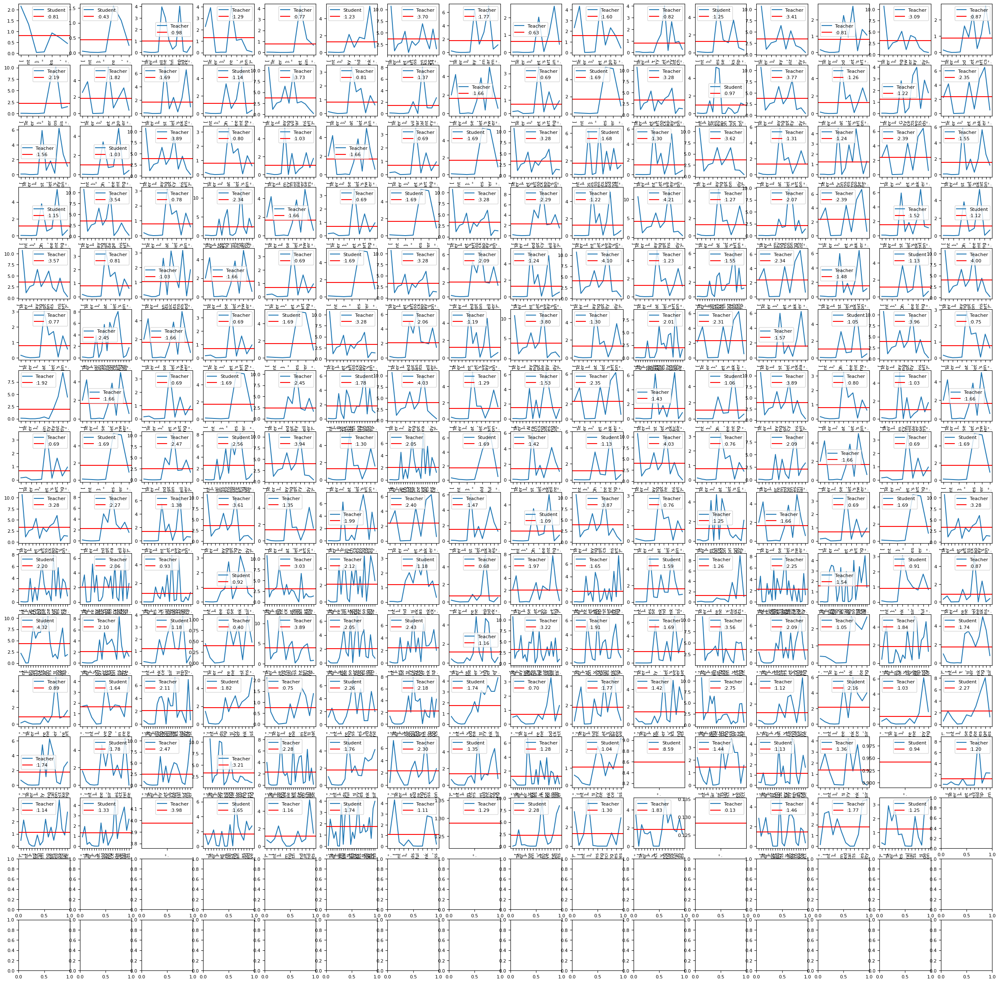

In [142]:
#information giving
tokens = per_label_dataset["Information giving"]
perplexity = per_label_ppl["Information giving"]
compute_graph_perplexity(tokens, perplexity)

In [129]:
len(per_label_ppl["Information giving"]), len(per_label_dataset["Information giving"])

(1732, 168)

In [146]:
perplexity = per_label_ppl["Neutral"]
np.nanmean(perplexity), np.nanstd(perplexity)

(1.1668811043698673, 1.5403075206732066)

In [147]:
perplexity = per_label_ppl["Information giving"]
np.nanmean(perplexity), np.nanstd(perplexity)

(1.873973837310217, 2.2824403575431496)

In [148]:
perplexity = per_label_ppl["Information seeking"]
np.nanmean(perplexity), np.nanstd(perplexity)

(2.5338201728730056, 2.734783707685525)

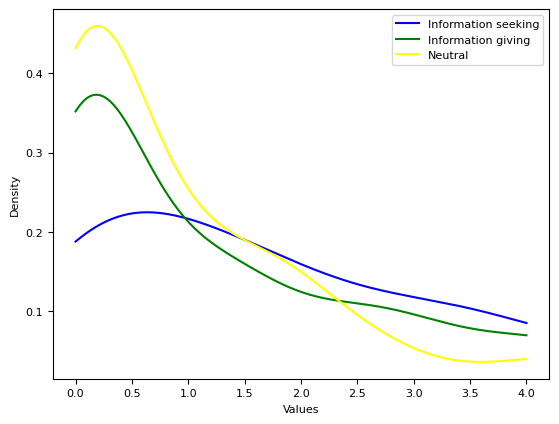

In [145]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming per_label_ppl is a dictionary containing data for "Information seeking" and "Information giving"

# Create a figure and axis
fig, ax = plt.subplots()

# Plot KDE using seaborn
sns.kdeplot(per_label_ppl["Information seeking"], color='blue', label='Information seeking', ax=ax, cut=0, clip=(0, 4))
sns.kdeplot(per_label_ppl["Information giving"], color='green', label='Information giving', ax=ax, cut=0, clip=(0, 4))
sns.kdeplot(per_label_ppl["Neutral"], color='yellow', label='Neutral', ax=ax, cut=0, clip=(0, 4))

# Adding labels and legend
ax.set_xlabel('Values')
ax.set_ylabel('Density')
ax.legend()

# Display the plot
plt.show()


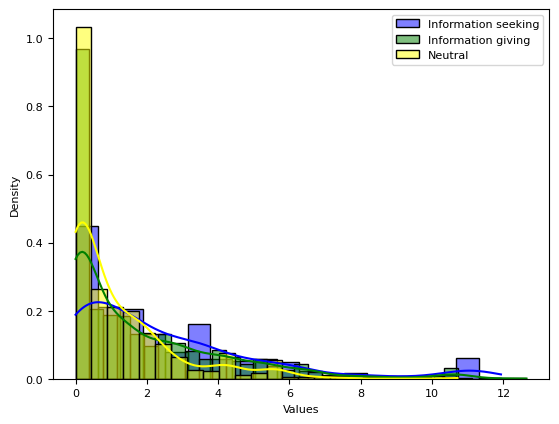

In [151]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming per_label_ppl is a dictionary containing data for "Information seeking" and "Information giving"

# Create a figure and axis
fig, ax = plt.subplots()

# Plot histograms using seaborn with density=True
sns.histplot(per_label_ppl["Information seeking"], kde=True, color='blue', label='Information seeking', ax=ax, stat='density')
sns.histplot(per_label_ppl["Information giving"], kde=True, color='green', label='Information giving', ax=ax, stat='density')
sns.histplot(per_label_ppl["Neutral"], kde=True, color='yellow', label='Neutral', ax=ax, stat='density')

# Adding labels and legend
ax.set_xlabel('Values')
ax.set_ylabel('Density')
ax.legend()

# Display the plot
plt.show()


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


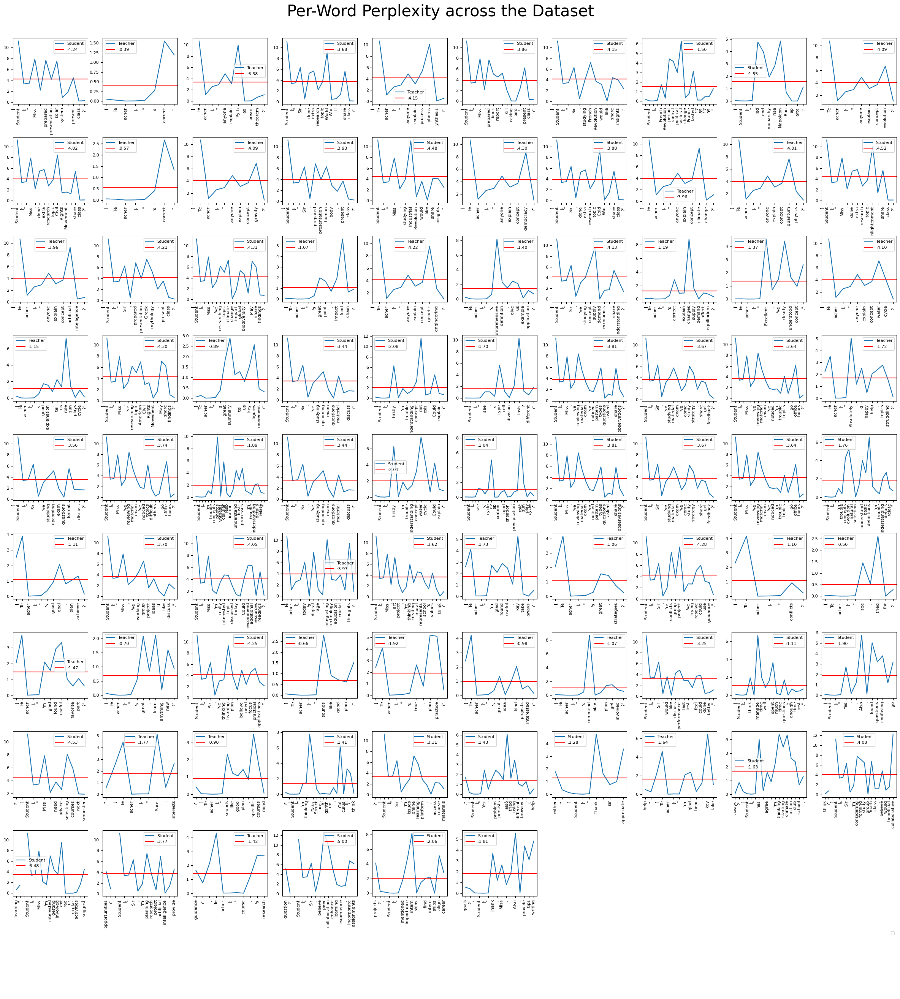

In [66]:
#lower perplexity
dataset = per_label_dataset["Information seeking"]
perplexity = per_label_ppl["Information seeking"]
pattern = r'\[([^\]]+)\]'
compute_graph_perplexity(dataset,perplexity)